# Noise

In [1]:
import numpy as np
import cv2
import pywt
import matplotlib.pyplot as plt
import pyshearlab
import random
import dtcwt
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim

## Salt and Pepper

In [2]:
def salt_pepper_noise(image, density):
    noisy_image = np.copy(image)
    height = noisy_image.shape[0]
    width = noisy_image.shape[1]
    
    # Amount of salt and pepper noise pixels
    noise_count = int(height * width * density)

    # Half of the noises are salt that its pixel value is 255
    # and half of them are pepper that its pixel value is 0
    for i in range(int(noise_count / 2)):
        salt_row = random.randint(0, height - 1)
        salt_col = random.randint(0, width - 1)

        pepper_row = random.randint(0, height - 1)
        pepper_col = random.randint(0, width - 1)

        noisy_image[salt_row, salt_col] = 255
        noisy_image[pepper_row, pepper_col] = 0

    return noisy_image

## Speckle

In [1]:
def speckle_noise(image, variance):
    sigma = np.sqrt(variance)
    noise = np.random.normal(0, sigma, image.shape)
    noisy_image = image + noise
    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)    
    return noisy_image

## Poisson

In [4]:
def poisson_noise(image, noise_scaling):
    # Compute the Poisson noise based on the noise scaling
    noise = np.random.poisson(image * noise_scaling) / noise_scaling
    noisy_image = image + noise
    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)
    return noisy_image

## Gaussian

In [5]:
def gaussian_noise(image, mean, standard_deviation):
    height = image.shape[0]
    width = image.shape[1]
    # Generate Gaussian noise with given mean and standard deviation
    gauss_noise = np.random.normal(mean, standard_deviation, (height, width))
    noisy_image = image + gauss_noise
    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)
    return noisy_image

# Filter

## Smoothing Filters

### Median

In [6]:
def median_filter(image, kernel_size):
    return cv2.medianBlur(image, kernel_size)

### Average

In [7]:
def average_filter(image, kernel_size):
    return cv2.blur(image, (kernel_size, kernel_size))

### Bilateral

In [8]:
def bilateral_filter(image, sigma_r, sigma_s):
    return cv2.bilateralFilter(image, -1, sigma_r, sigma_s)

## Sharpening Filters

### Laplacian

In [9]:
def laplacian_filter(image, kernel_size):
    high_pass = cv2.Laplacian(image, cv2.CV_64F, ksize=kernel_size)
    filtered_image = image + high_pass
    return np.uint8(np.abs(filtered_image))

### Denoising Laplacian

In [10]:
def Dlaplacian_filter(image, kernel_size):
    blurred_image = cv2.GaussianBlur(image, (kernel_size, kernel_size), 0)
    high_pass = cv2.Laplacian(blurred_image, cv2.CV_64F, ksize=kernel_size)
    # boosting noise
    k = 5
    high_pass = high_pass * k
    threshold1 = np.max(high_pass) * 0.9
    
    for i in range(high_pass.shape[0]):
        for j in range(high_pass.shape[1]):
            if high_pass[i, j] < threshold1:
                high_pass[i, j] = 0

    high_pass = high_pass * image
    # removing noise from image
    filtered_image = image - high_pass 
    threshold2 = np.max(filtered_image) * 0.9
    # removing remaining noise 
    for i in range(filtered_image.shape[0]):
        for j in range(filtered_image.shape[1]):
            if filtered_image[i, j] > threshold2:
                filtered_image[i, j] = 0

    filtered_image = np.uint8(np.clip(filtered_image, 0, 255))
    return filtered_image

### Denoising High Pass

In [11]:
def Dhighpass_filter(image, kernel_size):
    high_pass = cv2.Laplacian(image, cv2.CV_64F, ksize=kernel_size)
    # boosting noise
    k = 5
    high_pass = high_pass * k
    threshold1 = np.max(high_pass) * 0.9
    
    for i in range(high_pass.shape[0]):
        for j in range(high_pass.shape[1]):
            if high_pass[i, j] < threshold1:
                high_pass[i, j] = 0

    high_pass = high_pass * image
    # removing noise from image
    filtered_image = image - high_pass 
    threshold2 = np.max(filtered_image) * 0.9
    # removing remaining noise 
    for i in range(filtered_image.shape[0]):
        for j in range(filtered_image.shape[1]):
            if filtered_image[i, j] > threshold2:
                filtered_image[i, j] = 0

    filtered_image = np.uint8(np.clip(filtered_image, 0, 255))
    return filtered_image

### Sobel

In [12]:
def sobel_filter(image):
    sobel_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)
    gradient_magnitude = np.sqrt(sobel_x**2 + sobel_y**2)
    gradient_magnitude = np.uint8(np.abs(gradient_magnitude))
    filtered_image = image + gradient_magnitude
    return np.uint8(np.abs(filtered_image))

### Denoising Sobel

In [13]:
def Dsobel_filter(image):
    sobel_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)
    gradient_magnitude = np.sqrt(sobel_x**2 + sobel_y**2)
    gradient_magnitude = np.uint8(np.abs(gradient_magnitude))
    # boosting noise
    k = 10
    gradient_magnitude = gradient_magnitude * k
    threshold1 = np.max(gradient_magnitude) * 0.9
    
    for i in range(gradient_magnitude.shape[0]):
        for j in range(gradient_magnitude.shape[1]):
            if gradient_magnitude[i, j] < threshold1:
                gradient_magnitude[i, j] = 0

    gradient_magnitude = gradient_magnitude * image
    # removing noise from image
    filtered_image = image - gradient_magnitude 
    threshold2 = np.max(filtered_image) * 0.9
    # removing remaining noise 
    for i in range(filtered_image.shape[0]):
        for j in range(filtered_image.shape[1]):
            if filtered_image[i, j] > threshold2:
                filtered_image[i, j] = 0

    ffiltered_image = np.uint8(np.clip(filtered_image, 0, 255))
    return filtered_image

### Robert

In [14]:
def robert_filter(image):
    kernel_x = np.array([[-1, 0],
                         [0, 1]], dtype=np.float32)
    
    kernel_y = np.array([[0, -1],
                         [1, 0]], dtype=np.float32)

    robert_x = cv2.filter2D(image, -1, kernel_x)
    robert_y = cv2.filter2D(image, -1, kernel_y)
    gradient_magnitude = np.sqrt(robert_x**2 + robert_y**2)
    gradient_magnitude = np.uint8(np.abs(gradient_magnitude))
    c = 0.05
    filtered_image = image - c * gradient_magnitude
    return np.uint8(np.abs(filtered_image))

### ِDenoising Robert

In [15]:
def Drobert_filter(image):
    blurred_image = cv2.blur(image, (2, 2))
    kernel_x = np.array([[-1, 0],
                         [0, 1]], dtype=np.float32)
    
    kernel_y = np.array([[0, -1],
                         [1, 0]], dtype=np.float32)

    robert_x = cv2.filter2D(blurred_image, -1, kernel_x)
    robert_y = cv2.filter2D(blurred_image, -1, kernel_y)
    gradient_magnitude = np.sqrt(robert_x**2 + robert_y**2)
    gradient_magnitude = np.uint8(np.abs(gradient_magnitude))
     # boosting noise
    k = 10
    gradient_magnitude = gradient_magnitude * k
    threshold1 = np.max(gradient_magnitude) * 0.9
    
    for i in range(gradient_magnitude.shape[0]):
        for j in range(gradient_magnitude.shape[1]):
            if gradient_magnitude[i, j] < threshold1:
                gradient_magnitude[i, j] = 0

    gradient_magnitude = gradient_magnitude * image
    # removing noise from image
    filtered_image = image - gradient_magnitude 
    threshold2 = np.max(filtered_image) * 0.9
    # removing remaining noise 
    for i in range(filtered_image.shape[0]):
        for j in range(filtered_image.shape[1]):
            if filtered_image[i, j] > threshold2:
                filtered_image[i, j] = 0

    filtered_image = np.uint8(np.clip(filtered_image, 0, 255))
    return filtered_image

### Unsharp Masking

In [16]:
def unsharp_masking(image, kernel_size=3):
    blurred_image = cv2.GaussianBlur(image, (kernel_size, kernel_size), 1)
    high_pass = image.astype(np.float32) - blurred_image.astype(np.float32)
    k = 1
    filtered_image = image + k * high_pass
    filtered_image = np.clip(filtered_image, 0, 255).astype(np.uint8)
    return filtered_image

### Denoising Unsharp Masking

In [17]:
def Dunsharp_masking(image, kernel_size=3):
    blurred_image = cv2.GaussianBlur(image, (kernel_size, kernel_size), 1)
    high_pass = image.astype(np.float32) - blurred_image.astype(np.float32)
    # boosting noise
    c = 5
    high_pass = high_pass * c
    threshold1 = np.max(high_pass) * 0.9
    
    for i in range(high_pass.shape[0]):
        for j in range(high_pass.shape[1]):
            if high_pass[i, j] < threshold1:
                high_pass[i, j] = 0

    high_pass = high_pass * image
    # removing noise from image
    k = 1
    filtered_image = image - k * high_pass 
    threshold2 = np.max(filtered_image) * 0.9
    # removing remaining noise 
    for i in range(filtered_image.shape[0]):
        for j in range(filtered_image.shape[1]):
            if filtered_image[i, j] > threshold2:
                filtered_image[i, j] = 0

    filtered_image = np.uint8(np.clip(filtered_image, 0, 255))
    return filtered_image

### High Boost

In [18]:
def high_boost(image, kernel_size=3):
    blurred_image = cv2.GaussianBlur(image, (kernel_size, kernel_size), 1)
    high_pass = image.astype(np.float32) - blurred_image.astype(np.float32)
    k = 1.2
    filtered_image = image + k * high_pass
    filtered_image = np.clip(filtered_image, 0, 255).astype(np.uint8)
    return filtered_image

###  Denoising High Boost

In [19]:
def Dhigh_boost(image, kernel_size=3):
    blurred_image = cv2.GaussianBlur(image, (kernel_size, kernel_size), 1)
    high_pass = image.astype(np.float32) - blurred_image.astype(np.float32)
    # boosting noise
    c = 5
    high_pass = high_pass * c
    threshold1 = np.max(high_pass) * 0.9
    
    for i in range(high_pass.shape[0]):
        for j in range(high_pass.shape[1]):
            if high_pass[i, j] < threshold1:
                high_pass[i, j] = 0

    high_pass = high_pass * image
    # removing noise from image
    k = 1.2
    filtered_image = image - k * high_pass 
    threshold2 = np.max(filtered_image) * 0.9
    # removing remaining noise 
    for i in range(filtered_image.shape[0]):
        for j in range(filtered_image.shape[1]):
            if filtered_image[i, j] > threshold2:
                filtered_image[i, j] = 0

    filtered_image = np.uint8(np.clip(filtered_image, 0, 255))
    return filtered_image

## Wavelet

### Haar Wavelet

In [20]:
def haar_wavelet(image, levels, k=10):
    coeffs = pywt.wavedec2(image, 'haar', level=levels)
    all_coefficients = np.concatenate([np.abs(c).ravel() for c in coeffs])
    median_coeff = np.median(np.abs(all_coefficients))
    min_coeff = np.min(np.abs(all_coefficients))
    threshold = (min_coeff + median_coeff) / 2 + k
    thresholded_coeffs = []
    temp = ()

    for i, c in enumerate(coeffs): 
        if i == 0:  # Keep the approximation coefficients unchanged
            thresholded_coeffs.append(c)
        else:  # Apply thresholding to higher frequencies
            thresholded_coeffs.append(tuple(pywt.threshold(c, threshold, mode='soft')))
        temp = tuple(thresholded_coeffs)
       
    reconstructed_image = pywt.waverec2(temp, 'haar')
    reconstructed_image = np.clip(reconstructed_image, 0, 255).astype(np.uint8)
    return reconstructed_image

### Coiflet Wavelet

In [21]:
def coiflet_wavelet(image, levels=1, k=10):
    coeffs = pywt.wavedec2(image, 'coif1', level=levels)
    all_coefficients = np.concatenate([np.abs(c).ravel() for c in coeffs])
    median_coeff = np.median(np.abs(all_coefficients))
    min_coeff = np.min(np.abs(all_coefficients))
    threshold = (min_coeff + median_coeff) / 2 + k
    thresholded_coeffs = []
    temp = ()

    for i, c in enumerate(coeffs):
        if i == 0:  # Keep the approximation coefficients unchanged
            thresholded_coeffs.append(c)
        else:  # Apply thresholding to higher frequencies
            thresholded_coeffs.append(tuple(pywt.threshold(c, threshold, mode='soft')))

        temp = tuple(thresholded_coeffs)
       
            
    reconstructed_image = pywt.waverec2(temp, 'coif1')
    reconstructed_image = np.clip(reconstructed_image, 0, 255).astype(np.uint8)
    return reconstructed_image

### Daubechies Wavelet

In [22]:
def daubechies_wavelet(image, levels, k=10):
    coeffs = pywt.wavedec2(image, 'db1', level=levels)
    all_coefficients = np.concatenate([np.abs(c).ravel() for c in coeffs])
    median_coeff = np.median(np.abs(all_coefficients))
    min_coeff = np.min(np.abs(all_coefficients))
    threshold = (min_coeff + median_coeff) / 2 + k
    thresholded_coeffs = []
    temp = ()

    for i, c in enumerate(coeffs):
        if i == 0:  # Keep the approximation coefficients unchanged
            thresholded_coeffs.append(c)
        else:  # Apply thresholding to higher frequencies
            thresholded_coeffs.append(tuple(pywt.threshold(c, threshold, mode='soft')))

        temp = tuple(thresholded_coeffs)
       
            
    reconstructed_image = pywt.waverec2(temp, 'db1')
    reconstructed_image = np.clip(reconstructed_image, 0, 255).astype(np.uint8)
    return reconstructed_image


### Symlets Wavelet

In [23]:
def symlets_wavelet(image, levels, k=10):
    coeffs = pywt.wavedec2(image, 'sym2', level=levels)
    all_coefficients = np.concatenate([np.abs(c).ravel() for c in coeffs])
    median_coeff = np.median(np.abs(all_coefficients))
    min_coeff = np.min(np.abs(all_coefficients))
    threshold = (min_coeff + median_coeff) / 2 + k
    thresholded_coeffs = []
    temp = ()

    for i, c in enumerate(coeffs):
        if i == 0:  # Keep the approximation coefficients unchanged
            thresholded_coeffs.append(c)
        else:  # Apply thresholding to higher frequencies
            thresholded_coeffs.append(tuple(pywt.threshold(c, threshold, mode='soft')))

        temp = tuple(thresholded_coeffs)
       
            
    reconstructed_image = pywt.waverec2(temp, 'sym2')
    reconstructed_image = np.clip(reconstructed_image, 0, 255).astype(np.uint8)
    return reconstructed_image

## Shearlet

#### Shearlet is written in Matalab

In [24]:
# noisyImage = imread('salt_pepper_noise.jpg');
# % shearScale vary from 2 to 4
# shearScale = 4; 
# shearDirections = 4; 
# % k = 4 for salt and pepper
# % k = 7 for speckle
# % k = 6 for gaussian
# % k = 4 for possion
# k = 4; 
 
# % Normalize the image 
# noisyImage = double(noisyImage) / 255; 
 
# % Perform shearlet decomposition 
# shearletSystem = SLgetShearletSystem2D(0, size(noisyImage, 1), size(noisyImage, 2), shearScale, shearDirections); 
# coeffs = SLsheardec2D(noisyImage, shearletSystem); 

# threshold = (max(abs(coeffs(:))) - min(abs(coeffs(:)))) / k;
 
# for i = 1:numel(coeffs)
#     if abs(coeffs(i)) < threshold
#         coeffs(i) = 0;
#     end
# end 

# % shearlet reconstruction 
# denoisedImage = SLshearrec2D(coeffs, shearletSystem); 
# image = imread('med.jpg');
# image = im2double(image);
# denoisedImage = im2double(denoisedImage);
# imwrite(denoisedImage, 'denoisedsalt_pepper4.jpg', 'jpg');
# mse = immse(denoisedImage, image);
# max_intensity = 1;
# psnr = 10 * log10((max_intensity^2) / mse);
# ssim_val = ssim(denoisedImage, image);

# fprintf('MSE: %.4f\n', mse);
# fprintf('PSNR: %.2f dB\n', psnr);
# fprintf('SSIM: %.4f\n', ssim_val);



In [25]:
med_img = cv2.imread('DS/Med/1.png', cv2.IMREAD_GRAYSCALE)

Text(0.5, 1.0, 'original image')

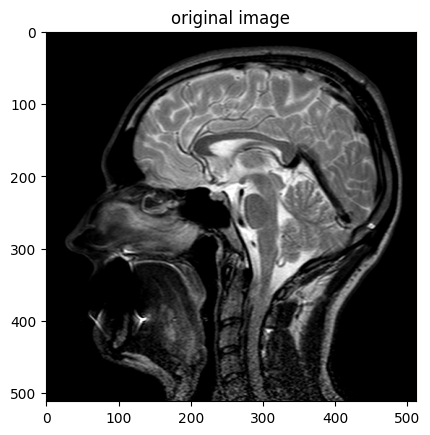

In [26]:
plt.imshow(med_img)
plt.set_cmap('gray')
plt.title('original image')

# Applying Salt and Pepper Noise

#### salt and pepper with different densities are applied. It can be seen that by increasing density, a noisier image is achieved and its MSE is increasing while SSIM and PSNR is decreasing means its difference with original image is increasing.

In [ ]:
Noisy_image = salt_pepper_noise(med_img, 0.05) 
plt.imshow(Noisy_image)
plt.title('Noisy image with 0.05 density')

MSE = np.mean((med_img - Noisy_image) ** 2)
SSIM = ssim(med_img, Noisy_image, multichannel=True)
PSNR = psnr(med_img, Noisy_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")


MSE: 5.743724822998047
SSIM: 0.23137711773652878
PSNR: 14.192463828911269 dB


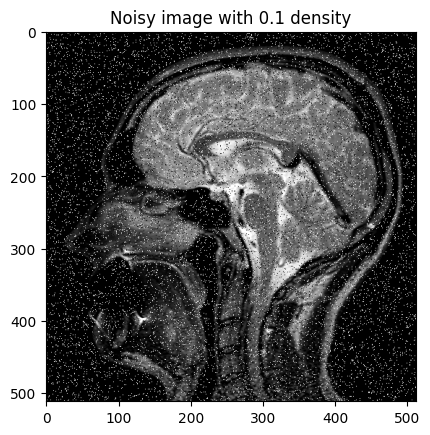

In [28]:
Noisy_image = salt_pepper_noise(med_img, 0.1) 
plt.imshow(Noisy_image)
plt.title('Noisy image with 0.1 density')

MSE = np.mean((med_img - Noisy_image) ** 2)
SSIM = ssim(med_img, Noisy_image, multichannel=True)
PSNR = psnr(med_img, Noisy_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Noisy_image = salt_pepper_noise(med_img, 0.2) 
plt.imshow(Noisy_image)
plt.title('Noisy image with 0.2 density')

MSE = np.mean((med_img - Noisy_image) ** 2)
SSIM = ssim(med_img, Noisy_image, multichannel=True)
PSNR = psnr(med_img, Noisy_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Noisy_image = salt_pepper_noise(med_img, 0.4) 
plt.imshow(Noisy_image)
plt.title('Noisy image with 0.4 density')

MSE = np.mean((med_img - Noisy_image) ** 2)
SSIM = ssim(med_img, Noisy_image, multichannel=True)
PSNR = psnr(med_img, Noisy_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

# Applying Filters for Salt-and-Pepper Noisy images

#### we choose image with density = 0.2 and apply filters to compare them

In [31]:
Noisy_image = salt_pepper_noise(med_img, 0.2) 
cv2.imwrite('salt_pepper_noise.png', Noisy_image)

True

## Apply Median Filter

MSE: 14.579700469970703
SSIM: 0.9453698106335123
PSNR: 30.092885276792728 dB


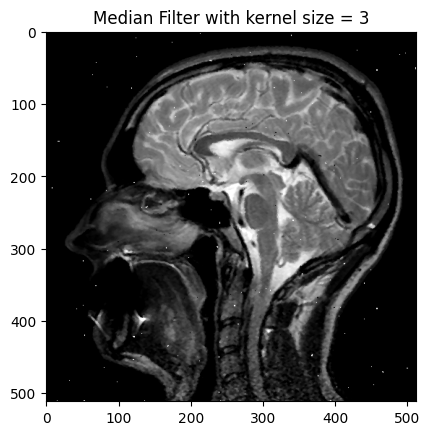

In [32]:
Filtered_image = median_filter(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('Median Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = median_filter(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('Median Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = median_filter(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('Median Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

#### As it can be seen in the images above, by increasing the kenrel size, we had better denoising while the smaller kernel size preserved finer details; SSIM and PSNR are decreasing at each step because of loosing details and MSE is increasing. kernel size 3x3 removed some amount of noise, but it did not completely eliminate all the salt-and-pepper noise. This kernel size preserved finer details but left some isolated noisy pixels untouched. A 5x5 kernel size had a stronger denoising effect compared to the 3x3 kernel.It removed more noise, including larger noisy areas, but it slightly blur the image compared to the smaller kernel. A 7x7 kernel had more pronounced smoothing effect.It removed more noise, including larger noisy patches, but it also blur the image more noticeably compared to smaller kernel sizes.

## Apply Average Filter

MSE: 64.65444564819336
SSIM: 0.306507209974641
PSNR: 18.880100360884054 dB


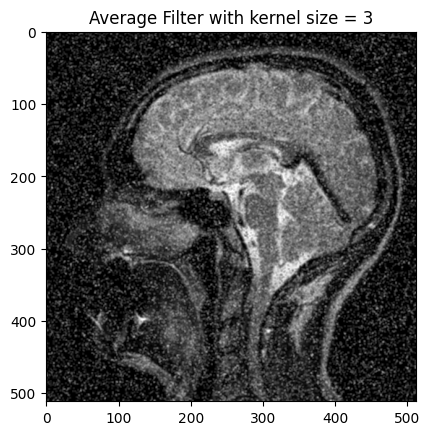

In [35]:
Filtered_image = average_filter(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('Average Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = average_filter(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('Average Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = average_filter(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('Average Filter with kernel size = 7 ')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

#### As it can be seen in the images above, the 3x3 kernel size resulted in a mild blur on the image and reduced some of the salt and pepper noise while preserving most of the image details. A 5x5 kernel size applied stronger blur, aiming to reduce more of the salt and pepper noise but some of image details are lost in compare to last kernel. Using a 7x7 kernel size, besides reducing more salt and pepper noise, resulted in a stronger blur, but causing more loss of image details. As we can see in achieved results, best kernel size is 5x5 that preserved fine image details while reducing noise up to a good level because this one has highest SSIM, that shows its structure is more like the original image. PSNR 3x3 kernel size is the lowest because it didn't reduce the noise as well as the other kernels and 7x7 kernel size reduced more noise in compare to previous kernels but also lost details so its difference with 5x5 kernel size is not a lot. MSE 3x3 kernel size is much less because it preserved details better, among 7x7 kernel size and 5x5 kernel size 7x7 kernel size reduced noise better while loosing image details so its MSE is a little lower.   

## Apply Bilateral Filter

In [ ]:
sigma_r = 70
sigma_s = 50
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 70 sigma_s = 50')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

MSE: 82.79867172241211
SSIM: 0.11620150493206502
PSNR: 13.686284461163783 dB


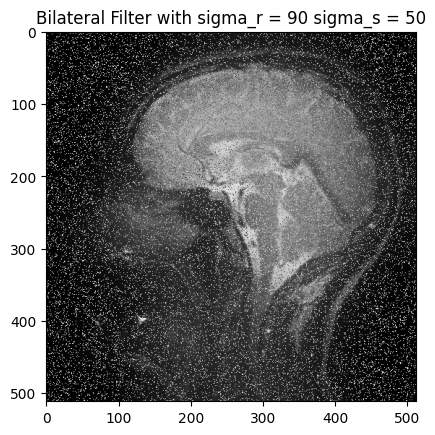

In [39]:
sigma_r = 90
sigma_s = 50
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 90 sigma_s = 50')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
sigma_r = 110
sigma_s = 50
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 110 sigma_s = 50')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
sigma_r = 70
sigma_s = 60
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 70 sigma_s = 60 ')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
sigma_r = 70
sigma_s = 80
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 70 sigma_s = 80 ')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
sigma_r = 70
sigma_s = 100
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 70 sigma_s = 100 ')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

#### As it can be seen in the first 3 images above, sigma_s = 50 and sigma_r differs from 70 to 110. sigma_r controls the bandwidth of the instensity gaussian so by increasing the amount of sigma_r, the image became blur more and more and it lost edge and details so MSE is increasing and SSIM is decreasing but slightly increase of PSNR shows that better noise reduction happened. As it can be seen in the second 3 images above, sigma_r = 70 and sigma_s differs from 60 to 100. sigma_s controls the spatial bandwidth so by increasing the amount of sigma_s, more pixels are encountering therefore more noise reduce as SSIM is increasing, it shows that the structure is a bit more like original image but it blurs some edge and details. To conclude, because the noisy pixels are too different from their neighbour in bilateral, it doesn't work well for this type of noise.

## Apply Denosing Sharpening Filters

## Apply Laplacian Filter

MSE: 11.45096206665039
SSIM: 0.6611459838597051
PSNR: 17.019328249780425 dB


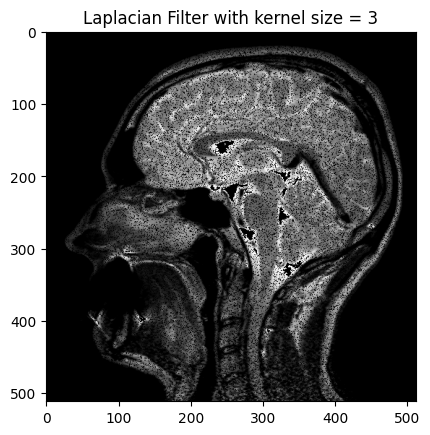

In [44]:
Filtered_image = Dlaplacian_filter(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dlaplacian_filter(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dlaplacian_filter(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

#### As it can be seen in the images above, by decreasing the kernel size, MSE is decreasing and SSIM and PSNR are increasing and higher quality image is achieved. In the laplacian denoising filter, at first gaussian filter applied to blur it and reduce noise then we calculate high pass by applying laplacian filter and then subtract it weighted from the noisy image to enhance edges while reducing noise. By increasing kernel size, the gaussian filter blurs the image more and more. In addition laplacian filter detects less detail and edge compare to smaller kernels instead, it detects larger boarders, edges and details so in general less noise reduction ocuurs.

## Apply High Pass Filter

MSE: 11.45260238647461
SSIM: 0.661139511310257
PSNR: 17.01931945103952 dB


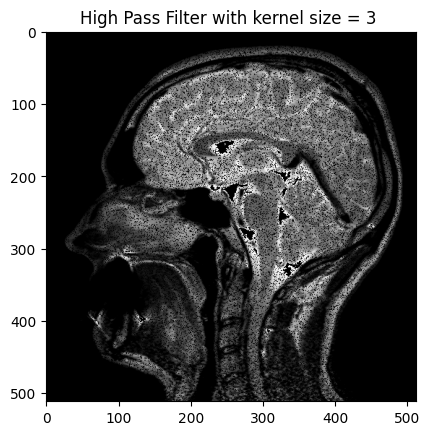

In [47]:
Filtered_image = Dhighpass_filter(Noisy_image, 3)

plt.imshow(Filtered_image)
plt.title('High Pass Filter with kernel size = 3 ')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dhighpass_filter(Noisy_image, 5)

plt.imshow(Filtered_image)
plt.title('High Pass Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dhighpass_filter(Noisy_image, 7)

plt.imshow(Filtered_image)
plt.title('High Pass Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Sobel Filter

MSE: 14.775882720947266
SSIM: 0.5523309988190527
PSNR: 15.96009031990187 dB


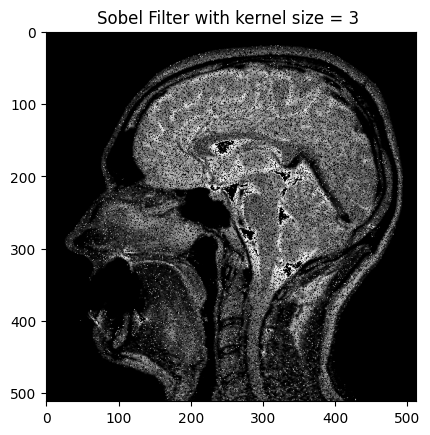

In [50]:
Filtered_image = Dsobel_filter(Noisy_image)

plt.imshow(Filtered_image)
plt.title('Sobel Filter with kernel size = 3 ')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Robert Filter

MSE: 15.218090057373047
SSIM: 0.5557904336475582
PSNR: 15.989950685700835 dB


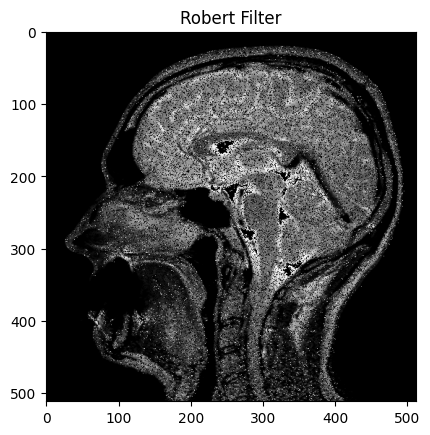

In [51]:
Filtered_image = Drobert_filter(Noisy_image)
plt.imshow(Filtered_image)
plt.title('Robert Filter')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Unsharp Masking Filter

MSE: 11.45096206665039
SSIM: 0.6611459838597051
PSNR: 17.019328249780425 dB


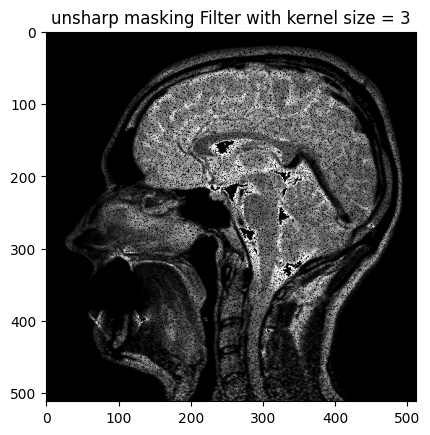

In [52]:
Filtered_image = Dunsharp_masking(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('unsharp masking Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dunsharp_masking(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('unsharp masking Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dunsharp_masking(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('unsharp masking Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply High Boost Filter

MSE: 11.45096206665039
SSIM: 0.6611459838597051
PSNR: 17.019328249780425 dB


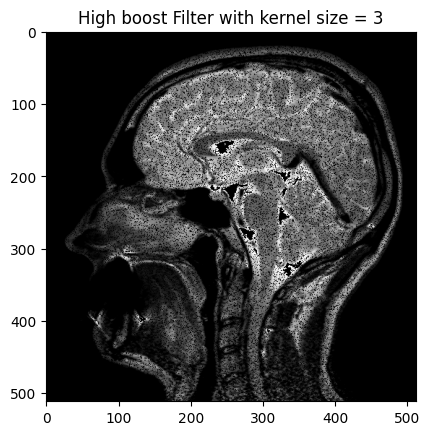

In [55]:
Filtered_image = Dhigh_boost(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dhigh_boost(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dhigh_boost(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Sharpening Filter

#### As it can be seen in the images below, Laplacian filters amplify noise more than other filters. It has highest MSE and lowest PSNR and SSIM.

## Apply Laplacian Filter

MSE: 56.21759796142578
SSIM: 0.002956693193545936
PSNR: 6.879401475366129 dB


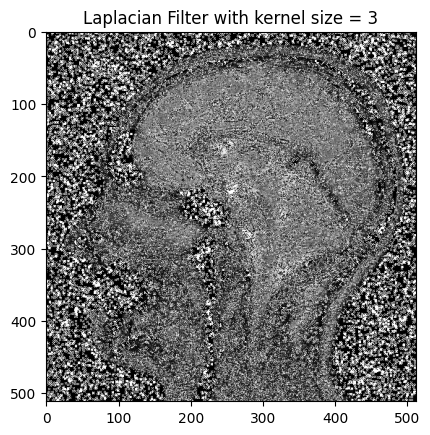

In [58]:
Filtered_image = laplacian_filter(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = laplacian_filter(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

MSE: 11.451866149902344
SSIM: 0.6611471755446665
PSNR: 17.019325209980167 dB


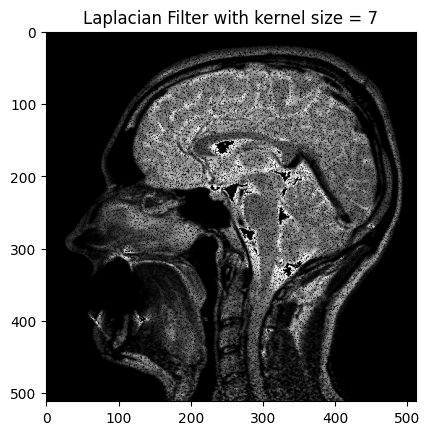

In [60]:
Filtered_image = Dlaplacian_filter(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Sobel Filter

MSE: 75.49198913574219
SSIM: 0.013044210696327928
PSNR: 6.824027299598965 dB


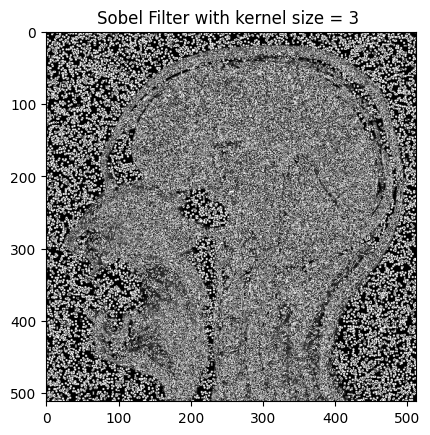

In [61]:
Filtered_image = sobel_filter(Noisy_image)

plt.imshow(Filtered_image)
plt.title('Sobel Filter with kernel size = 3 ')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Robert Filter

MSE: 11.47906494140625
SSIM: 0.11337822045703363
PSNR: 11.436363947358792 dB


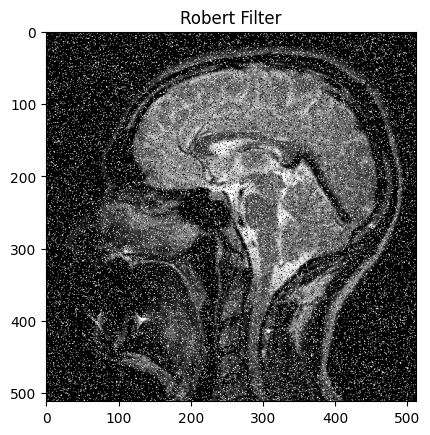

In [62]:
Filtered_image = robert_filter(Noisy_image)
plt.imshow(Filtered_image)
plt.title('Robert Filter')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Unsharp Masking Filter

MSE: 45.624305725097656
SSIM: 0.11688761315792484
PSNR: 11.283604741851818 dB


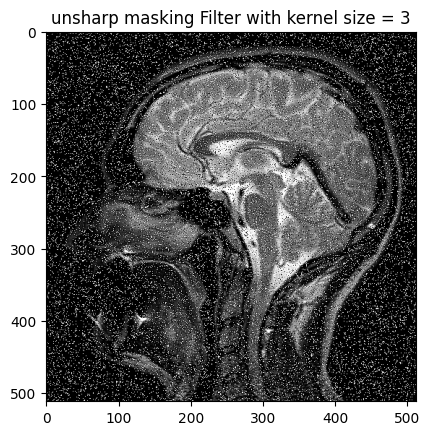

In [63]:
Filtered_image = unsharp_masking(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('unsharp masking Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

MSE: 11.45096206665039
SSIM: 0.6611459838597051
PSNR: 17.019328249780425 dB


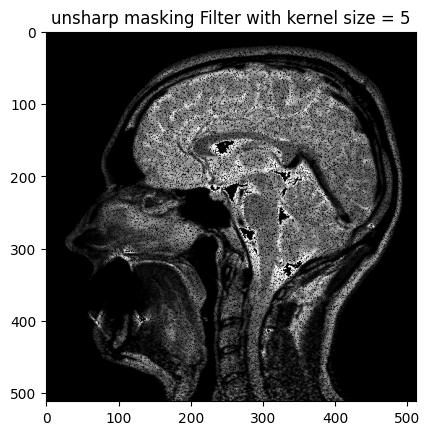

In [64]:
Filtered_image = Dunsharp_masking(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('unsharp masking Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dunsharp_masking(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('unsharp masking Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply High Boost Filter

MSE: 47.888275146484375
SSIM: 0.11610218926567059
PSNR: 11.241027163444501 dB


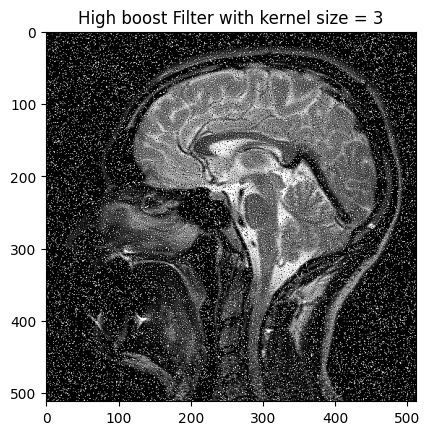

In [66]:
Filtered_image = high_boost(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = high_boost(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = high_boost(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Haar Wavelet Filter

MSE: 79.77413940429688
SSIM: 0.2094968379551871
PSNR: 16.213028621919673 dB


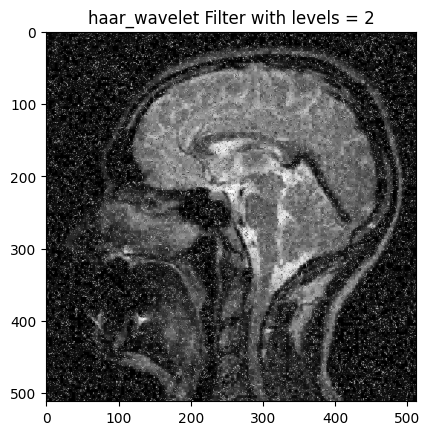

In [69]:
Filtered_image = haar_wavelet(Noisy_image, 2, 60)
plt.imshow(Filtered_image)
plt.title('haar_wavelet Filter with levels = 2')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = haar_wavelet(Noisy_image, 3, 60)
plt.imshow(Filtered_image)
plt.title('haar_wavelet Filter with levels = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = haar_wavelet(Noisy_image, 4, 60)
plt.imshow(Filtered_image)
plt.title('haar_wavelet Filter with levels = 4')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Coiflet Wavelet Filter

In [ ]:
Filtered_image = coiflet_wavelet(Noisy_image,2, 60)
plt.imshow(Filtered_image)
plt.title('coiflet_wavelet Filter with levels = 2 ')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = coiflet_wavelet(Noisy_image, 3, 60)
plt.imshow(Filtered_image)
plt.title('coiflet_wavelet Filter with levels = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

MSE: 88.89234924316406
SSIM: 0.192067222612927
PSNR: 17.08698702581217 dB


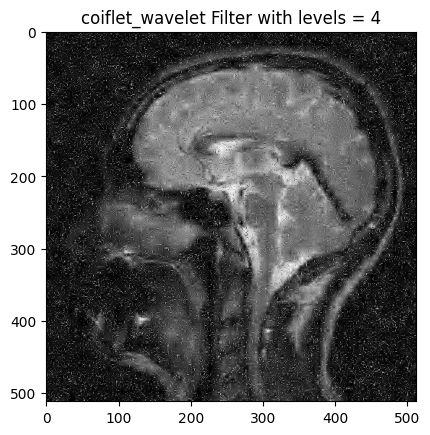

In [74]:
Filtered_image = coiflet_wavelet(Noisy_image, 4, 60)
plt.imshow(Filtered_image)
plt.title('coiflet_wavelet Filter with levels = 4')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Daubechies Wavelet Filter

MSE: 79.77413940429688
SSIM: 0.2094968379551871
PSNR: 16.213028621919673 dB


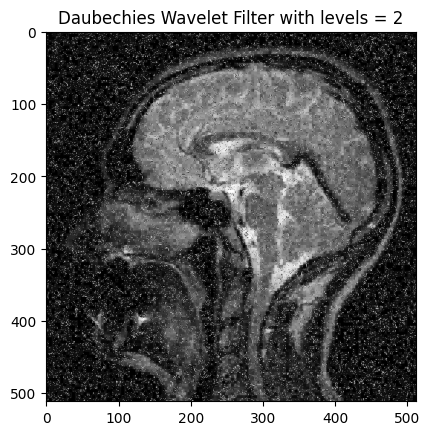

In [75]:
Filtered_image = daubechies_wavelet(Noisy_image, 2, 60)
plt.imshow(Filtered_image)
plt.title('Daubechies Wavelet Filter with levels = 2')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = daubechies_wavelet(Noisy_image, 3, 60)
plt.imshow(Filtered_image)
plt.title('Daubechies Wavelet Filter with levels = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = daubechies_wavelet(Noisy_image, 4, 60)
plt.imshow(Filtered_image)
plt.title('Daubechies Wavelet Filter with levels = 4')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Symlets Wavelet Filter

MSE: 81.87711334228516
SSIM: 0.23090234082964445
PSNR: 16.80254250869959 dB


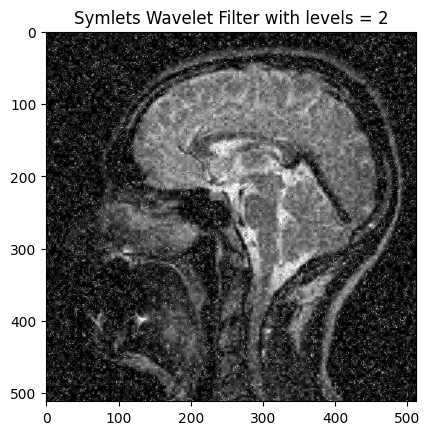

In [78]:
Filtered_image = symlets_wavelet(Noisy_image, 2, 60)
plt.imshow(Filtered_image)
plt.title('Symlets Wavelet Filter with levels = 2')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

MSE: 86.33068466186523
SSIM: 0.2104406462199532
PSNR: 17.11549887864708 dB


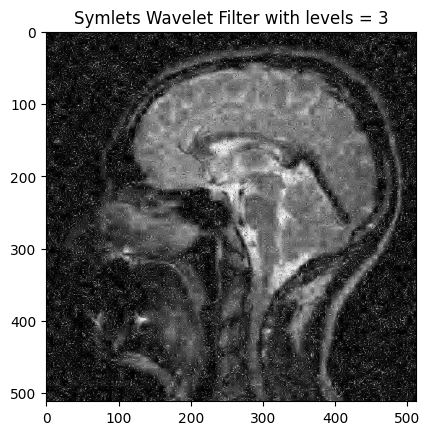

In [79]:
Filtered_image = symlets_wavelet(Noisy_image, 3, 60)
plt.imshow(Filtered_image)
plt.title('Symlets Wavelet Filter with levels = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = symlets_wavelet(Noisy_image, 4, 60)
plt.imshow(Filtered_image)
plt.title('Symlets Wavelet Filter with levels = 4')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Shearlet Filter

MSE: 0.0208
SSIM: 0.1859
PSNR: 16.81 dB


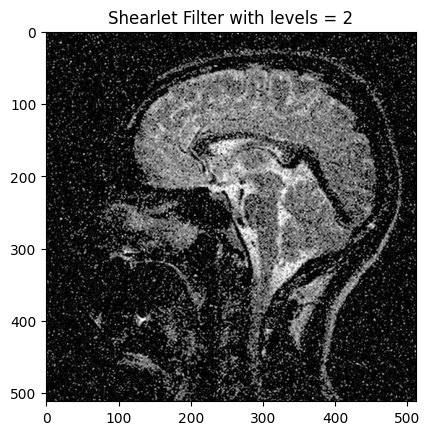

In [81]:
Filtered_image = cv2.imread('denoisedsalt_pepper2.jpg', cv2.IMREAD_GRAYSCALE)
plt.imshow(Filtered_image)
plt.title('Shearlet Filter with levels = 2')
MSE = 0.0208
SSIM = 0.1859
PSNR = 16.81

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = cv2.imread('denoisedsalt_pepper3.jpg', cv2.IMREAD_GRAYSCALE)
plt.imshow(Filtered_image)
plt.title('Shearlet Filter with levels = 3')
MSE = 0.0208
SSIM = 0.1859
PSNR = 16.81

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = cv2.imread('denoisedsalt_pepper4.jpg', cv2.IMREAD_GRAYSCALE)
plt.imshow(Filtered_image)
plt.title('Shearlet Filter with levels = 4')
MSE = 0.0208
SSIM = 0.1859
PSNR = 16.81

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [84]:
def add_padding(image, n_size):
    height = image.shape[0]
    width = image.shape[1]
    return cv2.copyMakeBorder(image, 0, n_size - height, 0, n_size - width, cv2.BORDER_CONSTANT)

In [85]:
def statistic_salt_pepper(dataSet_type, images_count):
    avg_filter_ssim = []
    avg_filter_psnr = []

    images_count += 1
    
    for filter in range(13):
            if filter == 0:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = salt_pepper_noise(image, 0.2)
                    Filtered_image = median_filter(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
                
            
            elif filter == 1:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = salt_pepper_noise(image, 0.2)
                    Filtered_image = average_filter(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
                
            
            elif filter == 2:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = salt_pepper_noise(image, 0.2)
                    sigma_r = 70
                    sigma_s = 80
                    Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 3:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = salt_pepper_noise(image, 0.2)
                    Filtered_image = Dlaplacian_filter(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 4:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = salt_pepper_noise(image, 0.2)
                    Filtered_image = Dhighpass_filter(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 5:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = salt_pepper_noise(image, 0.2)
                    Filtered_image = Dsobel_filter(Noisy_image)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            elif filter == 6:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = salt_pepper_noise(image, 0.2)
                    Filtered_image = Drobert_filter(Noisy_image)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    

            elif filter == 7:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = salt_pepper_noise(image, 0.2)
                    Filtered_image = Dunsharp_masking(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
           
            elif filter == 8:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = salt_pepper_noise(image, 0.2)
                    Filtered_image = Dhigh_boost(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 9:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    if image.shape[0] != image.shape[1]:
                        image = add_padding(image, max(image.shape[0], image.shape[1]))
                    Noisy_image = salt_pepper_noise(image, 0.2)
                    Filtered_image = haar_wavelet(Noisy_image, 3, 60)
                    if image.shape[0] != Filtered_image.shape[0]:
                        image = add_padding(image, max(image.shape[0], Filtered_image.shape[0]))
                        Filtered_image = add_padding(Filtered_image, max(image.shape[0], Filtered_image.shape[0]))
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            elif filter == 10:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    if image.shape[0] != image.shape[1]:
                        image = add_padding(image, max(image.shape[0], image.shape[1]))
                    Noisy_image = salt_pepper_noise(image, 0.2)
                    Filtered_image = coiflet_wavelet(Noisy_image, 3, 60)
                    if image.shape[0] != Filtered_image.shape[0]:
                        image = add_padding(image, max(image.shape[0], Filtered_image.shape[0]))
                        Filtered_image = add_padding(Filtered_image, max(image.shape[0], Filtered_image.shape[0]))
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
           
            elif filter == 11:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    if image.shape[0] != image.shape[1]:
                        image = add_padding(image, max(image.shape[0], image.shape[1]))
                    Noisy_image = salt_pepper_noise(image, 0.2)
                    Filtered_image = daubechies_wavelet(Noisy_image, 3, 60)
                    if image.shape[0] != Filtered_image.shape[0]:
                        image = add_padding(image, max(image.shape[0], Filtered_image.shape[0]))
                        Filtered_image = add_padding(Filtered_image, max(image.shape[0], Filtered_image.shape[0]))
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 12:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    if image.shape[0] != image.shape[1]:
                        image = add_padding(image, max(image.shape[0], image.shape[1]))
                    Noisy_image = salt_pepper_noise(image, 0.2)
                    Filtered_image = symlets_wavelet(Noisy_image, 3, 60)
                    if image.shape[0] != Filtered_image.shape[0]:
                        image = add_padding(image, max(image.shape[0], Filtered_image.shape[0]))
                        Filtered_image = add_padding(Filtered_image, max(image.shape[0], Filtered_image.shape[0]))
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
    filters = ['Median', 'Average', 'Bilateral', 'Laplacian', 'High Pass', 'Sobel', 'Robert', 'Unsharp masking', 
           'High Boost', 'Haar Wavelet', 'Coifler Wavelet', 'Daubechies Wavelet', 'Symlets Wavelet']
    print(dataSet_type + ' Images')
    # Plotting SSIM scores
    plt.figure(figsize=(20, 5))
    plt.bar(filters, avg_filter_ssim, color='skyblue')
    max_ssim = max(avg_filter_ssim)
    for i, value in enumerate(avg_filter_ssim):
        if value == max_ssim:
            plt.bar(i, value, color='blue')
    plt.xlabel('Filters')
    plt.ylabel('Average SSIM Score')
    plt.title('Average SSIM Scores for Different Filters')
    plt.tight_layout() 
    plt.show()

    # Plotting PSNR scores
    plt.figure(figsize=(20, 5))
    plt.bar(filters, avg_filter_psnr, color='salmon')
    max_psnr = max(avg_filter_psnr)
    for i, value in enumerate(avg_filter_psnr):
        if value == max_psnr:
            plt.bar(i, value, color='red')
    plt.xlabel('Filters')
    plt.ylabel('Average PSNR Score')
    plt.title('Average PSNR Scores for Different Filters')
    plt.tight_layout() 
    plt.show()


Med Images


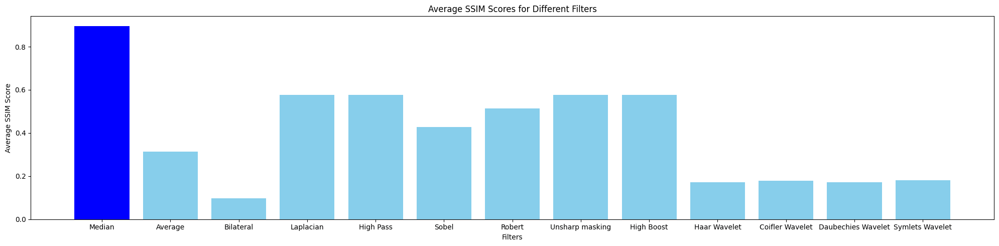

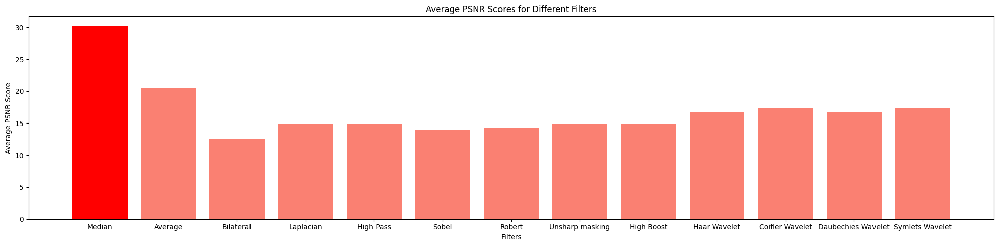

In [86]:
statistic_salt_pepper('Med', 24)

Normal Images


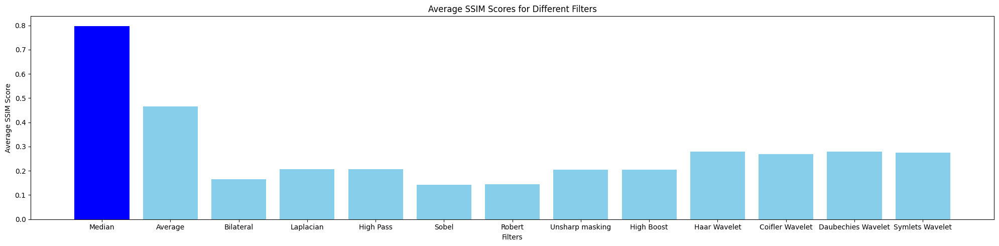

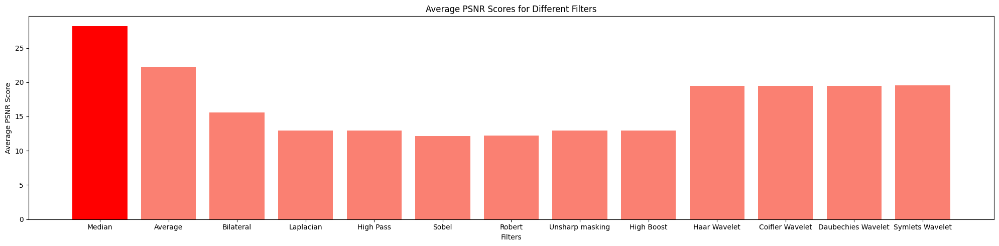

In [87]:
statistic_salt_pepper('Normal', 15)

RS Images


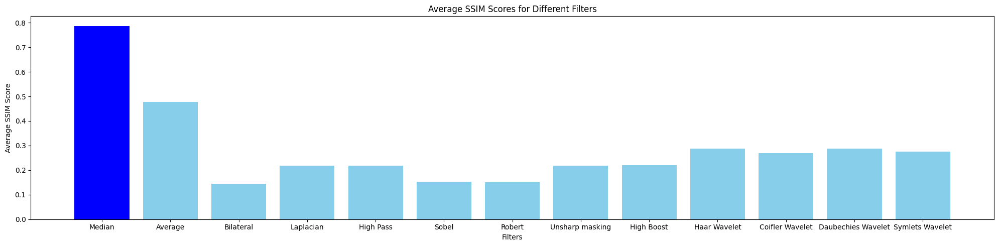

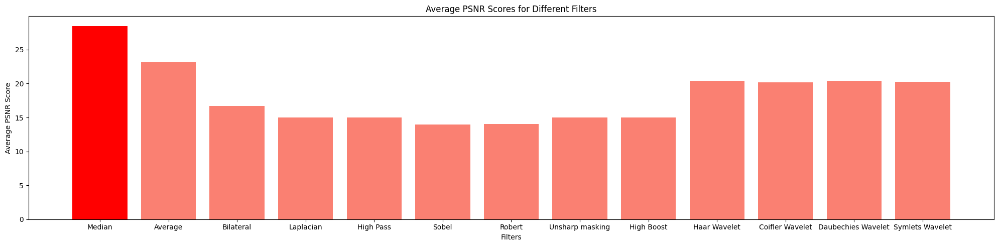

In [88]:
statistic_salt_pepper('RS', 15)

# Applying Speckle Noise

#### Speckle noise with different variances are applied. It can be seen that by increasing variance, a noisier image is achieved and its MSE is increasing while SSIM and PSNR is decreasing means its difference with original image is increasing.

In [ ]:
Noisy_image = speckle_noise(med_img, 0.0001) 
plt.imshow(Noisy_image)
plt.title('Noisy image with variance = 0.0001')

MSE = np.mean((med_img - Noisy_image) ** 2)
SSIM = ssim(med_img, Noisy_image, multichannel=True)
PSNR = psnr(med_img, Noisy_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Noisy_image = speckle_noise(med_img, 0.0005) 
plt.imshow(Noisy_image)
plt.title('Noisy image with variance = 0.0005')

MSE = np.mean((med_img - Noisy_image) ** 2)
SSIM = ssim(med_img, Noisy_image, multichannel=True)
PSNR = psnr(med_img, Noisy_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Noisy_image = speckle_noise(med_img, 0.001) 
plt.imshow(Noisy_image)
plt.title('Noisy image with variance = 0.001')

MSE = np.mean((med_img - Noisy_image) ** 2)
SSIM = ssim(med_img, Noisy_image, multichannel=True)
PSNR = psnr(med_img, Noisy_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

MSE: 0.28603363037109375
SSIM: 0.9994506212193501
PSNR: 53.56663262613211 dB


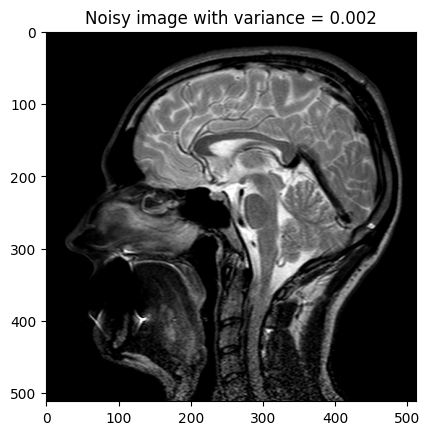

In [92]:
Noisy_image = speckle_noise(med_img, 0.002) 
plt.imshow(Noisy_image)
plt.title('Noisy image with variance = 0.002')

MSE = np.mean((med_img - Noisy_image) ** 2)
SSIM = ssim(med_img, Noisy_image, multichannel=True)
PSNR = psnr(med_img, Noisy_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

# Applying Filters for Speckle Noisy images

#### we choose image with variance = 0.002 and apply filters to compare them

In [93]:
Noisy_image = speckle_noise(med_img, 0.002) 
cv2.imwrite('speckle_noise.png', Noisy_image)

True

## Apply Median Filter

MSE: 7.6331329345703125
SSIM: 0.9830053643394752
PSNR: 38.326274317942804 dB


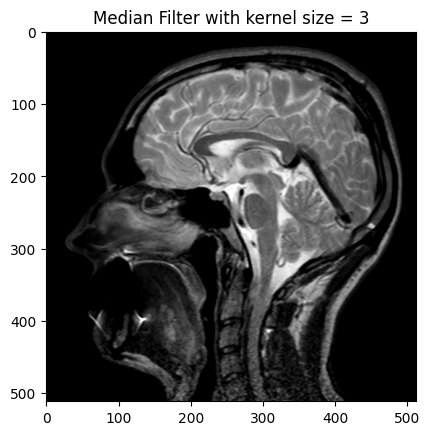

In [94]:
Filtered_image = median_filter(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('Median Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = median_filter(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('Median Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = median_filter(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('Median Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

#### As it can be seen in the images above, by increasing the kenrel size, we had better denoising while the smaller kernel size preserved finer details; SSIM and PSNR are decreasing at each step because of loosing details and MSE is increasing. 

## Apply Average Filter

In [ ]:
Filtered_image = average_filter(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('Average Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

MSE: 32.2380256652832
SSIM: 0.8836305793629956
PSNR: 29.55290188652142 dB


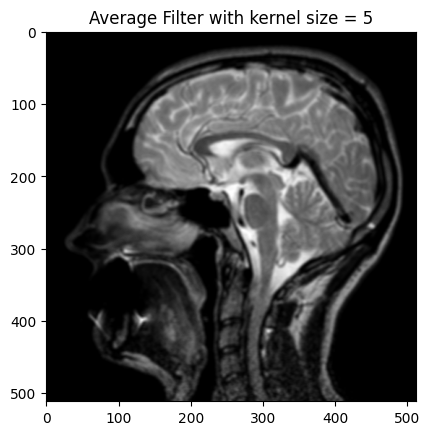

In [98]:
Filtered_image = average_filter(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('Average Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = average_filter(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('Average Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

#### As it can be seen in the images above, by increasing the kernel size, images become blur more and more and more image details are loosing so that MSE is increasing and SSIM and PSNR are decreasing by loosing edges and details and general structure of the image. 

## Apply Bilateral Filter

MSE: 75.41700744628906
SSIM: 0.5355869151889603
PSNR: 21.245519026792326 dB


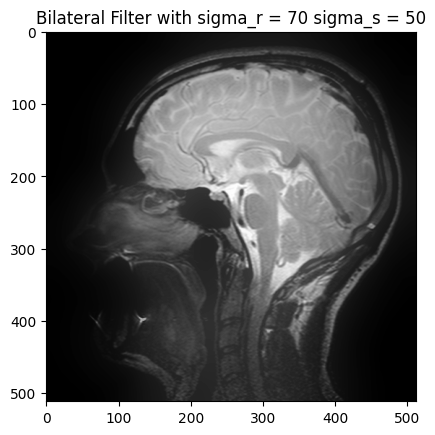

In [100]:
sigma_r = 70
sigma_s = 50
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 70 sigma_s = 50')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
sigma_r = 90
sigma_s = 50
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 90 sigma_s = 50 ')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

MSE: 83.04802703857422
SSIM: 0.4041522708921367
PSNR: 19.02386050410099 dB


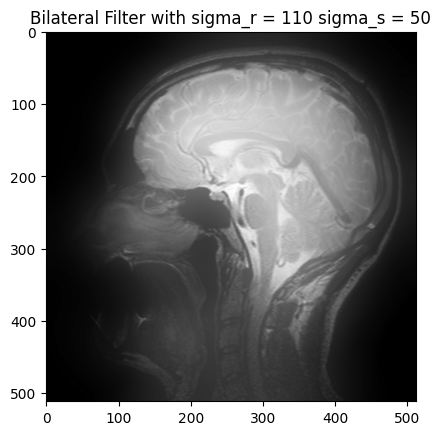

In [102]:
sigma_r = 110
sigma_s = 50
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 110 sigma_s = 50')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
sigma_r = 70
sigma_s = 60
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 70 sigma_s = 60')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
sigma_r = 70
sigma_s = 80
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 70 sigma_s = 80')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
sigma_r = 70
sigma_s = 100
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 70 sigma_s = 100')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

#### As it can be seen in the first 3 images above, sigma_s = 50 and sigma_r differs from 70 to 110. sigma_r controls the bandwidth of the instensity gaussian and A larger sigma_r means more neighboring pixels with differing intensities are included in the filtering process so by increasing this factor, image become blur and smooth more and more and loose some details while reduce noise more. because the effect of smoothing is more than denoising MSE is increasing and PSNR and SSIM are decreasing. As it can be seen in the second 3 images above, sigma_r = 70 and sigma_s differs from 60 to 100. sigma_s controls the spatial bandwidth so by increasing the amount of sigma_s, encompass a wider spatial area and it cause to blur more and loss details. because the effect of smoothing is more than denoising MSE is increasing and PSNR and SSIM are decreasing slightly.

## Apply Denosing Sharpening Filters

## Apply Laplacian Filter

In [ ]:
Filtered_image = Dlaplacian_filter(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

MSE: 0.7310447692871094
SSIM: 0.9799852698356207
PSNR: 23.166256174713567 dB


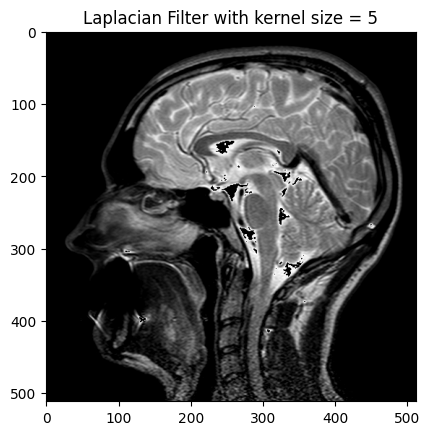

In [107]:
Filtered_image = Dlaplacian_filter(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dlaplacian_filter(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

#### As it can be seen in the images above, by decreasing the kernel size, MSE is decreasing and SSIM and PSNR are increasing and higher quality image is achieved. In the laplacian denoising filter, at first gaussian filter applied to blur it and reduce noise then we calculate high pass by applying laplacian filter and then subtract it weighted from the noisy image to enhance edges while reducing noise. By increasing kernel size, the gaussian filter blurs the image more and more. In addition laplacian filter detects less detail and edge compare to smaller kernels instead, it detects larger boarders, edges and details so in general less noise reduction ocuurs. To conclude, salt and pepper is random noise and this type of denoising is not suitable.

## Apply High Pass Filter

MSE: 0.7300376892089844
SSIM: 0.979984366123499
PSNR: 23.166297162401094 dB


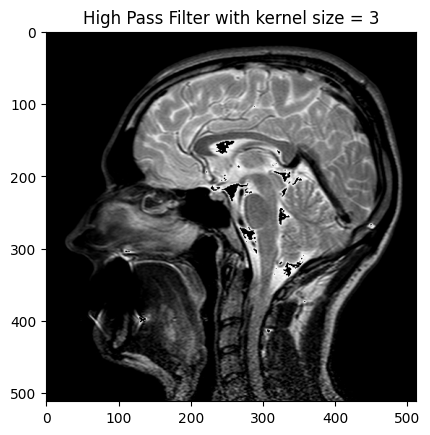

In [109]:
Filtered_image = Dhighpass_filter(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('High Pass Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dhighpass_filter(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('High Pass Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dhighpass_filter(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('High Pass Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Sobel Filter

MSE: 6.297290802001953
SSIM: 0.6765512264152291
PSNR: 19.411983266183 dB


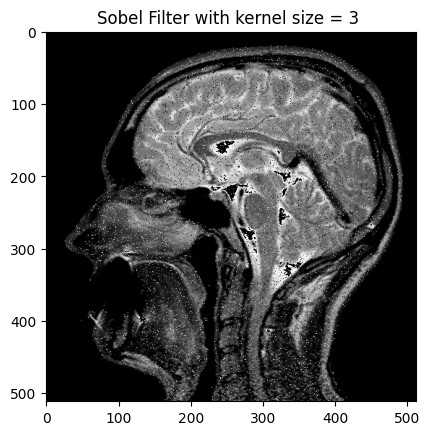

In [112]:
Filtered_image = Dsobel_filter(Noisy_image)

plt.imshow(Filtered_image)
plt.title('Sobel Filter with kernel size = 3 ')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Robert Filter

MSE: 4.697292327880859
SSIM: 0.792977633346569
PSNR: 20.20063190603418 dB


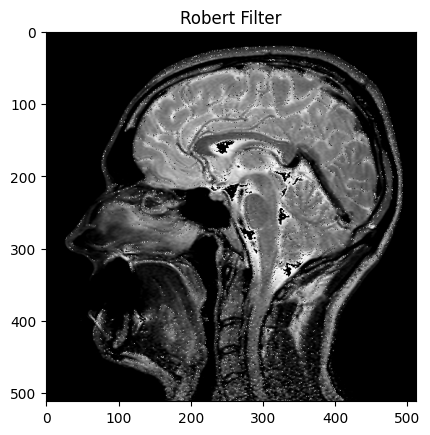

In [113]:
Filtered_image = Drobert_filter(Noisy_image)
plt.imshow(Filtered_image)
plt.title('Robert Filter')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Unsharp Masking Filter

MSE: 0.7300376892089844
SSIM: 0.979984366123499
PSNR: 23.166297162401094 dB


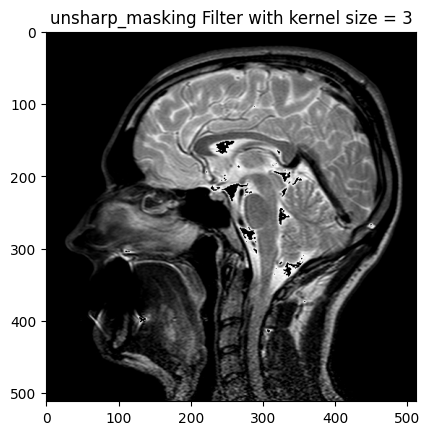

In [114]:
Filtered_image = Dunsharp_masking(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('unsharp_masking Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dunsharp_masking(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('unsharp_masking Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

MSE: 0.7300376892089844
SSIM: 0.979984366123499
PSNR: 23.166297162401094 dB


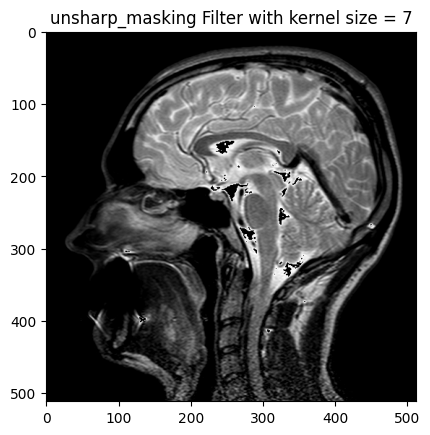

In [116]:
Filtered_image = Dunsharp_masking(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('unsharp_masking Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply High Boost Filter

MSE: 0.7300376892089844
SSIM: 0.979984366123499
PSNR: 23.166297162401094 dB


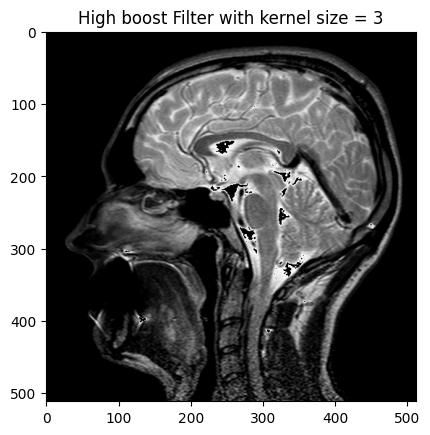

In [117]:
Filtered_image = Dhigh_boost(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dhigh_boost(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dhigh_boost(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Sharpening Filter

#### As it can be seen in the images below, Laplacian filters amplify noise more than other filters. It has highest MSE and lowest PSNR and SSIM.

## Apply Laplacian Filter

MSE: 60.64356231689453
SSIM: 0.2692814357814159
PSNR: 16.153019184866103 dB


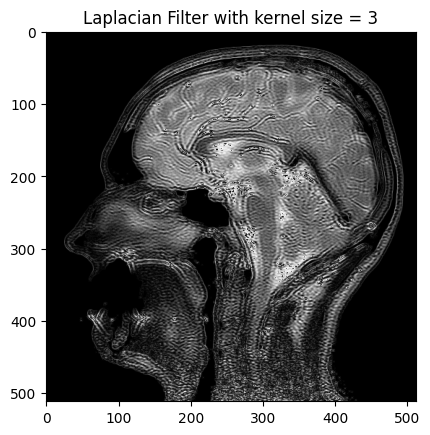

In [120]:
Filtered_image = laplacian_filter(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = laplacian_filter(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = laplacian_filter(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Sobel Filter

MSE: 67.36743927001953
SSIM: 0.4063125104695876
PSNR: 11.790048325781408 dB


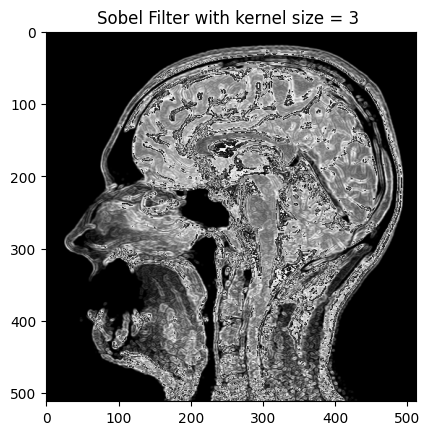

In [123]:
Filtered_image = sobel_filter(Noisy_image)

plt.imshow(Filtered_image)
plt.title('Sobel Filter with kernel size = 3 ')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Robert Filter

MSE: 1.0925788879394531
SSIM: 0.9984291812362888
PSNR: 47.74627556543622 dB


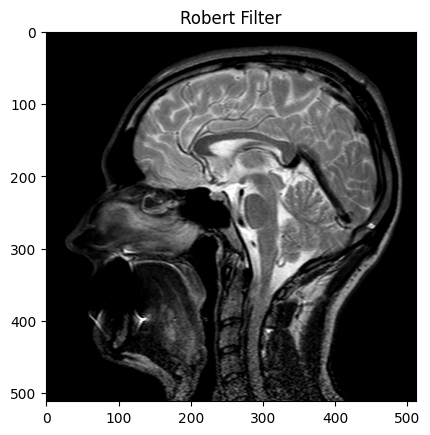

In [124]:
Filtered_image = robert_filter(Noisy_image)
plt.imshow(Filtered_image)
plt.title('Robert Filter')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Unsharp Masking Filter

MSE: 9.113357543945312
SSIM: 0.9878895816138847
PSNR: 38.15074964626402 dB


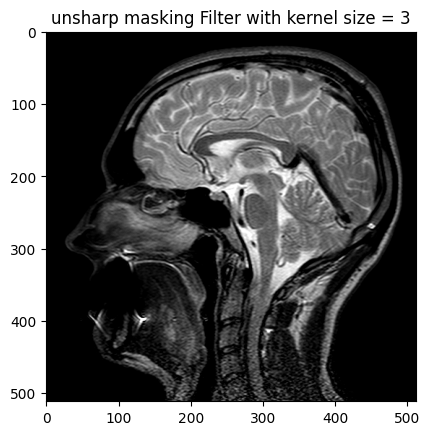

In [125]:
Filtered_image = unsharp_masking(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('unsharp masking Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = unsharp_masking(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('unsharp masking Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = unsharp_masking(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('unsharp masking Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply High Boost Filter

In [ ]:
Filtered_image = high_boost(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = high_boost(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = high_boost(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Haar Wavelet Filter

MSE: 38.459442138671875
SSIM: 0.8242445900404934
PSNR: 27.366772139605978 dB


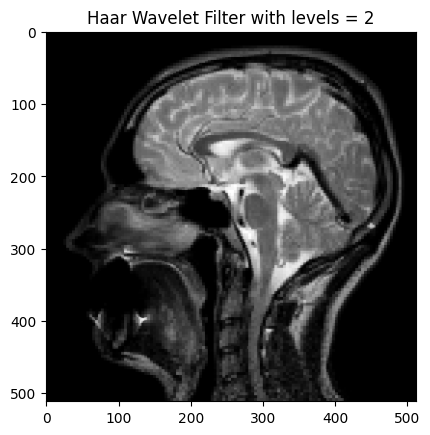

In [131]:
Filtered_image = haar_wavelet(Noisy_image, 2, 60)
plt.imshow(Filtered_image)
plt.title('Haar Wavelet Filter with levels = 2')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = haar_wavelet(Noisy_image, 3, 60)
plt.imshow(Filtered_image)
plt.title('Haar Wavelet Filter with levels = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = haar_wavelet(Noisy_image, 4, 60)
plt.imshow(Filtered_image)
plt.title('Haar Wavelet Filter with levels = 4')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Coiflet Wavelet Filter

MSE: 34.54258346557617
SSIM: 0.8727332159530833
PSNR: 29.436388951161767 dB


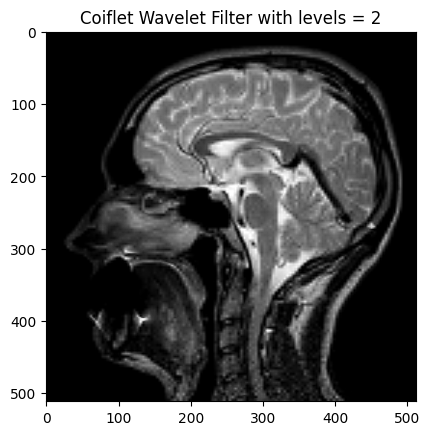

In [134]:
Filtered_image = coiflet_wavelet(Noisy_image, 2, 60)
plt.imshow(Filtered_image)
plt.title('Coiflet Wavelet Filter with levels = 2')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = coiflet_wavelet(Noisy_image, 3, 60)
plt.imshow(Filtered_image)
plt.title('Coiflet Wavelet Filter with levels = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = coiflet_wavelet(Noisy_image, 4, 60)
plt.imshow(Filtered_image)
plt.title('Coiflet Wavelet Filter with levels = 4')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Daubechies Wavelet Filter

MSE: 38.459442138671875
SSIM: 0.8242445900404934
PSNR: 27.366772139605978 dB


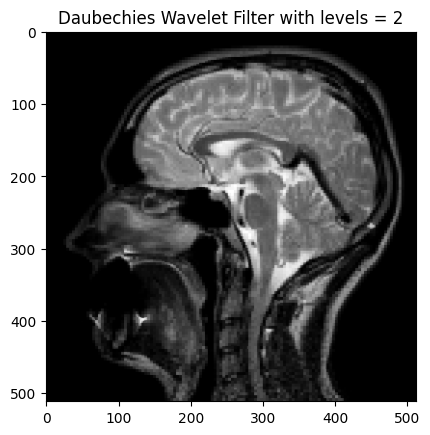

In [137]:
Filtered_image = daubechies_wavelet(Noisy_image, 2, 60)
plt.imshow(Filtered_image)
plt.title('Daubechies Wavelet Filter with levels = 2')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = daubechies_wavelet(Noisy_image, 3, 60)
plt.imshow(Filtered_image)
plt.title('Daubechies Wavelet Filter with levels = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = daubechies_wavelet(Noisy_image, 4, 60)
plt.imshow(Filtered_image)
plt.title('Daubechies Wavelet Filter with levels = 4')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Symlets Wavelet Filter

MSE: 34.685943603515625
SSIM: 0.869477621467964
PSNR: 29.297605355442453 dB


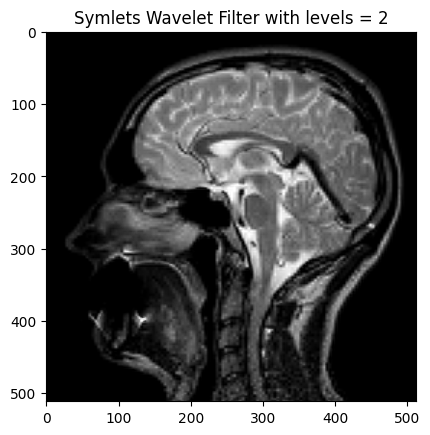

In [140]:
Filtered_image = symlets_wavelet(Noisy_image, 2, 60)
plt.imshow(Filtered_image)
plt.title('Symlets Wavelet Filter with levels = 2')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = symlets_wavelet(Noisy_image, 3, 60)
plt.imshow(Filtered_image)
plt.title('Symlets Wavelet Filter with levels = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = symlets_wavelet(Noisy_image, 4, 60)
plt.imshow(Filtered_image)
plt.title('Symlets Wavelet Filter with levels = 4')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Shearlet Filter

MSE: 0.0011
SSIM: 0.8579
PSNR: 29.43 dB


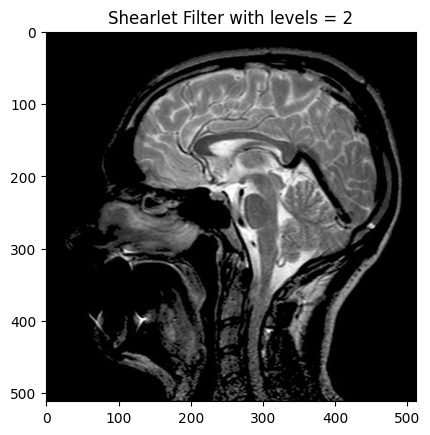

In [143]:
Filtered_image = cv2.imread('denoisedspeckle2.jpg', cv2.IMREAD_GRAYSCALE)
plt.imshow(Filtered_image)
plt.title('Shearlet Filter with levels = 2')
MSE = 0.0011
SSIM = 0.8579
PSNR = 29.43

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = cv2.imread('denoisedspeckle3.jpg', cv2.IMREAD_GRAYSCALE)
plt.imshow(Filtered_image)
plt.title('Shearlet Filter with levels = 3')
MSE = 0.0011
SSIM = 0.8579
PSNR = 29.43

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = cv2.imread('denoisedspeckle4.jpg', cv2.IMREAD_GRAYSCALE)
plt.imshow(Filtered_image)
plt.title('Shearlet Filter with levels = 4')
MSE = 0.0011
SSIM = 0.8579
PSNR = 29.43

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [146]:
def statistic_speckle(dataSet_type, images_count):
    avg_filter_ssim = []
    avg_filter_psnr = []

    images_count += 1
    
    for filter in range(13):
            if filter == 0:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = speckle_noise(image, 0.002) 
                    Filtered_image = median_filter(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
                
            
            elif filter == 1:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = speckle_noise(image, 0.002) 
                    Filtered_image = average_filter(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
                
            
            elif filter == 2:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = speckle_noise(image, 0.002) 
                    sigma_r = 70
                    sigma_s = 80
                    Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 3:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = speckle_noise(image, 0.002) 
                    Filtered_image = Dlaplacian_filter(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 4:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = speckle_noise(image, 0.002) 
                    Filtered_image = Dhighpass_filter(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 5:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = speckle_noise(image, 0.002) 
                    Filtered_image = Dsobel_filter(Noisy_image)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            elif filter == 6:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = speckle_noise(image, 0.002) 
                    Filtered_image = Drobert_filter(Noisy_image)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    

            elif filter == 7:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = speckle_noise(image, 0.002) 
                    Filtered_image = Dunsharp_masking(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
           
            elif filter == 8:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = speckle_noise(image, 0.002) 
                    Filtered_image = Dhigh_boost(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 9:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    if image.shape[0] != image.shape[1]:
                        image = add_padding(image, max(image.shape[0], image.shape[1]))
                    Noisy_image = speckle_noise(image, 0.002) 
                    Filtered_image = haar_wavelet(Noisy_image, 3, 60)
                    if image.shape[0] != Filtered_image.shape[0]:
                        image = add_padding(image, max(image.shape[0], Filtered_image.shape[0]))
                        Filtered_image = add_padding(Filtered_image, max(image.shape[0], Filtered_image.shape[0]))
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            elif filter == 10:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    if image.shape[0] != image.shape[1]:
                        image = add_padding(image, max(image.shape[0], image.shape[1]))
                    Noisy_image = speckle_noise(image, 0.002) 
                    Filtered_image = coiflet_wavelet(Noisy_image, 3, 60)
                    if image.shape[0] != Filtered_image.shape[0]:
                        image = add_padding(image, max(image.shape[0], Filtered_image.shape[0]))
                        Filtered_image = add_padding(Filtered_image, max(image.shape[0], Filtered_image.shape[0]))
                    
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
           
            elif filter == 11:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    if image.shape[0] != image.shape[1]:
                        image = add_padding(image, max(image.shape[0], image.shape[1]))
                    Noisy_image = speckle_noise(image, 0.002) 
                    Filtered_image = daubechies_wavelet(Noisy_image, 3, 60)
                    if image.shape[0] != Filtered_image.shape[0]:
                        image = add_padding(image, max(image.shape[0], Filtered_image.shape[0]))
                        Filtered_image = add_padding(Filtered_image, max(image.shape[0], Filtered_image.shape[0]))
                    
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 12:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    if image.shape[0] != image.shape[1]:
                        image = add_padding(image, max(image.shape[0], image.shape[1]))
                    Noisy_image = speckle_noise(image, 0.002) 
                    Filtered_image = symlets_wavelet(Noisy_image, 3, 60)
                    if image.shape[0] != Filtered_image.shape[0]:
                        image = add_padding(image, max(image.shape[0], Filtered_image.shape[0]))
                        Filtered_image = add_padding(Filtered_image, max(image.shape[0], Filtered_image.shape[0]))
                    
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
    filters = ['Median', 'Average', 'Bilateral', 'Laplacian', 'High Pass', 'Sobel', 'Robert', 'Unsharp masking', 
           'High Boost', 'Haar Wavelet', 'Coifler Wavelet', 'Daubechies Wavelet', 'Symlets Wavelet']
    print(dataSet_type + ' Images')
    # Plotting SSIM scores
    plt.figure(figsize=(20, 5))
    plt.bar(filters, avg_filter_ssim, color='skyblue')
    max_ssim = max(avg_filter_ssim)
    for i, value in enumerate(avg_filter_ssim):
        if value == max_ssim:
            plt.bar(i, value, color='blue')
    plt.xlabel('Filters')
    plt.ylabel('Average SSIM Score')
    plt.title('Average SSIM Scores for Different Filters')
    plt.tight_layout() 
    plt.show()

    # Plotting PSNR scores
    plt.figure(figsize=(20, 5))
    plt.bar(filters, avg_filter_psnr, color='salmon')
    max_psnr = max(avg_filter_psnr)
    for i, value in enumerate(avg_filter_psnr):
        if value == max_psnr:
            plt.bar(i, value, color='red')
    plt.xlabel('Filters')
    plt.ylabel('Average PSNR Score')
    plt.title('Average PSNR Scores for Different Filters')
    plt.tight_layout() 
    plt.show()


Med Images


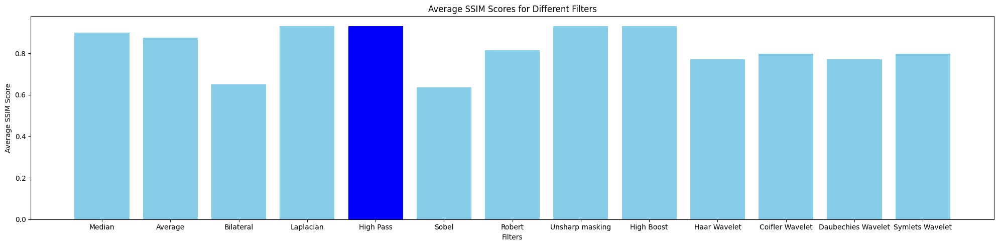

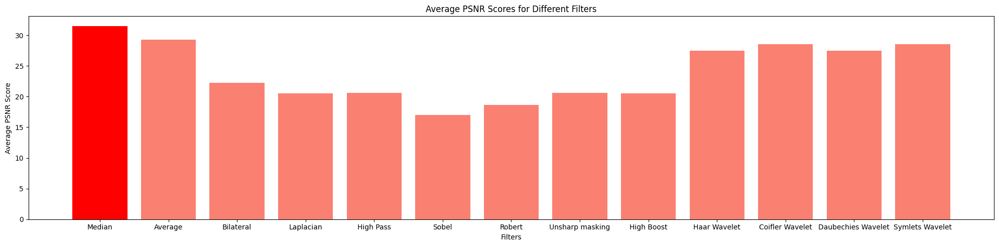

In [147]:
statistic_speckle('Med', 24)

Normal Images


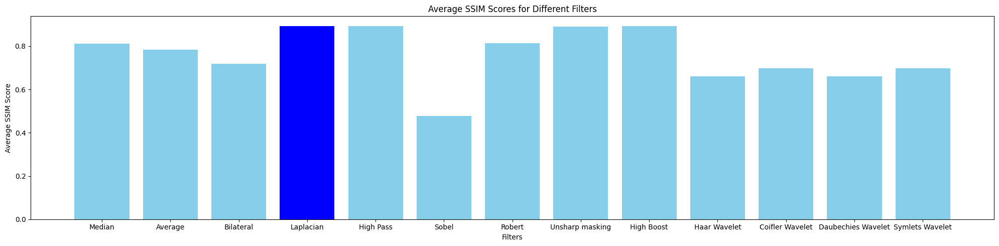

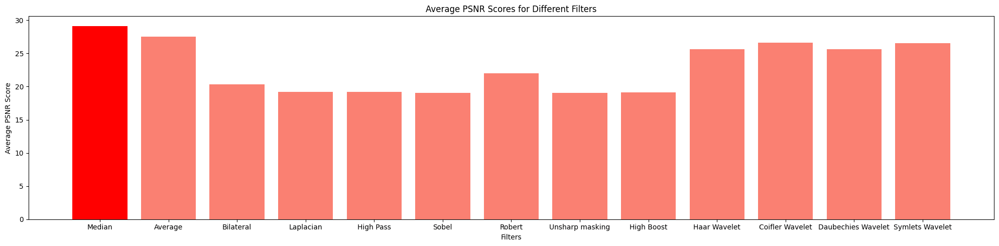

In [148]:
statistic_speckle('Normal', 15)

RS Images


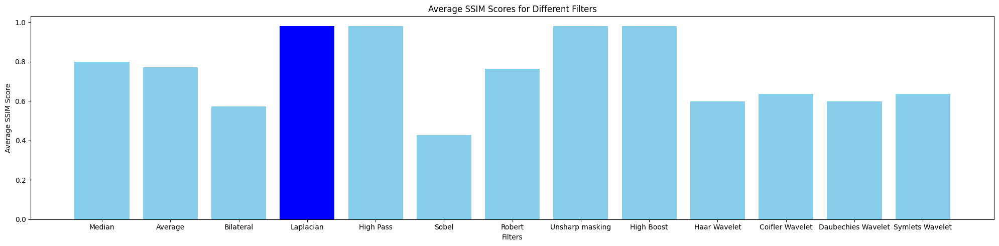

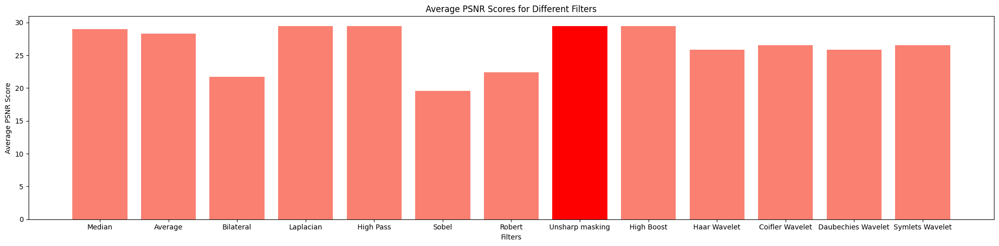

In [149]:
statistic_speckle('RS', 15)

# Applying Poisson Noise

#### Possion noise with different scalings are applied. By increasing scaling factor, MSE and SSIM and PSNR are increasing up to a point. Increasing in MSE shows increasing noise. SSIM and PSNR metrics measure image quality and fidelity by comparing the original and noisy images. In certain cases, moderate levels of Poisson noise might not significantly affect these metrics. As the scale parameter increases, the noise becomes more apparent, but it dpesn't distort the structural similarity or the mean square difference excessively.SSIM takes into account structural information, luminance, and contrast. For certain levels of Poisson noise, the change in luminance might not affect the structural similarity significantly, especially if edges and details remain relatively intact. PSNR measures the ratio of signal to noise, and moderate increases in Poisson noise might not drastically decrease the peak signal while increasing the noise component, hence a moderate change in PSNR. But it can be seen that at scale = 2, the noise becomes too intense and SSIM starts to decrease due to distortions affecting the structural information, and PSNR also starts to decrease more significantly due to increased noise intensity dominating the signal.

MSE: 46.86647033691406
SSIM: 0.6570437493273823
PSNR: 12.545504634909628 dB


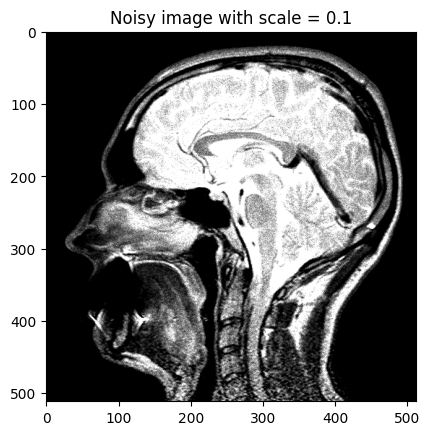

In [150]:
Noisy_image = poisson_noise(med_img, 0.1) 
plt.imshow(Noisy_image)
plt.title('Noisy image with scale = 0.1')

MSE = np.mean((med_img - Noisy_image) ** 2)
SSIM = ssim(med_img, Noisy_image, multichannel=True)
PSNR = psnr(med_img, Noisy_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Noisy_image = poisson_noise(med_img, 0.5) 
plt.imshow(Noisy_image)
plt.title('Noisy image with scale = 0.5')

MSE = np.mean((med_img - Noisy_image) ** 2)
SSIM = ssim(med_img, Noisy_image, multichannel=True)
PSNR = psnr(med_img, Noisy_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Noisy_image = poisson_noise(med_img, 1) 
plt.imshow(Noisy_image)
plt.title('Noisy image with scale = 1')

MSE = np.mean((med_img - Noisy_image) ** 2)
SSIM = ssim(med_img, Noisy_image, multichannel=True)
PSNR = psnr(med_img, Noisy_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Noisy_image = poisson_noise(med_img, 2) 
plt.imshow(Noisy_image)
plt.title('Noisy image with scale = 2')

MSE = np.mean((med_img - Noisy_image) ** 2)
SSIM = ssim(med_img, Noisy_image, multichannel=True)
PSNR = psnr(med_img, Noisy_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

# Applying Filters for Possion Noisy images

#### we choose image with scaling factor = 0.5 and apply filters to compare them

In [154]:
Noisy_image = poisson_noise(med_img, 0.5) 
cv2.imwrite('poisson_noise.png', Noisy_image)

True

## Apply Median Filter

MSE: 57.690853118896484
SSIM: 0.7623577811311743
PSNR: 12.601496247867562 dB


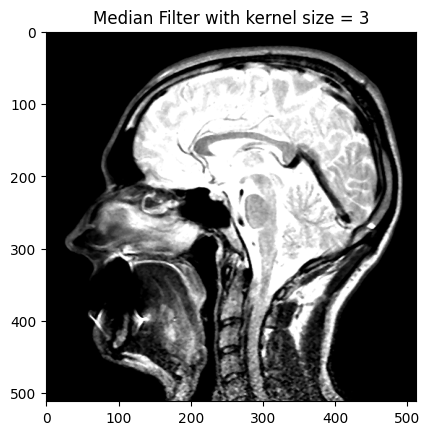

In [155]:
Filtered_image = median_filter(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('Median Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = median_filter(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('Median Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = median_filter(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('Median Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

#### As it can be seen in the images above, by increasing the kenrel size, images blur more and more while the smaller kernel size preserved finer details; SSIM and PSNR are decreasing at each step because of blurring and loosing details and MSE is increasing. It can be concluded for Possion noise, median filter is not the best choice. 

## Apply Average Filter

MSE: 66.03045654296875
SSIM: 0.7732376353506393
PSNR: 12.749457906835612 dB


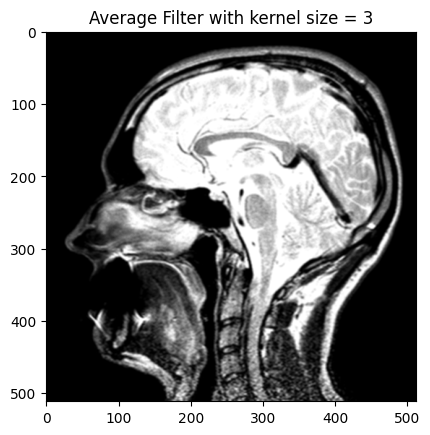

In [158]:
Filtered_image = average_filter(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('Average Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = average_filter(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('Average Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = average_filter(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('Average Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

#### As it can be seen in the images above, by increasing the kernel size, images become blur more and more and more details and edges of image is loosing at each step however, noise is reducing too.PSNR is increasing so its denoisng effect is a bit more that blurring but because of loosing details and edges SSIM and MSE which show structure and pixel differences with original image are decreasing.    

## Apply Bilateral Filter

MSE: 84.08547592163086
SSIM: 0.5359516073110652
PSNR: 13.18245196745248 dB


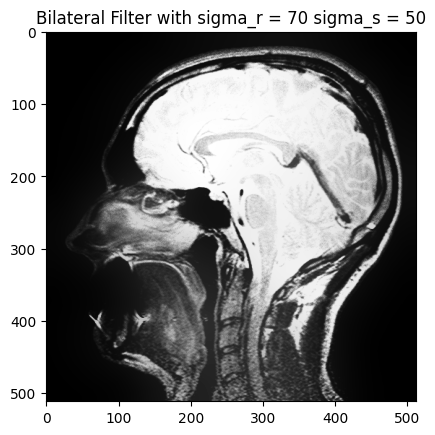

In [161]:
sigma_r = 70
sigma_s = 50
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 70 sigma_s = 50')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
sigma_r = 90
sigma_s = 50
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 90 sigma_s = 50')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
sigma_r = 110
sigma_s = 50
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 110 sigma_s = 50')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
sigma_r = 70
sigma_s = 60
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 70 sigma_s = 60')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
sigma_r = 70
sigma_s = 80
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 70 sigma_s = 80')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
sigma_r = 70
sigma_s = 100
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 70 sigma_s = 100')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

#### As it can be seen in the first 3 images above, sigma_s = 50 and sigma_r differs from 70 to 110. sigma_r controls the bandwidth of the instensity gaussian and A larger sigma_r means more neighboring pixels with differing intensities are included in the filtering process so by increasing this factor, image become smoother and loose some details while reduce more noise. because of loosing details and edges MSE is increasing and SSIM is dcreasing.The effect of denoising is a bit more than smoothing so PSNR is slightly increasing. As it can be seen in the second 3 images above, sigma_r = 70 and sigma_s differs from 60 to 100. sigma_s controls the spatial bandwidth so by increasing the amount of sigma_s, encompass a wider spatial area and it cause to blur more and loss details. because of loosing details and edges MSE is increasing and SSIM is dcreasing.The effect of denoising is a bit more than smoothing so PSNR is slightly increasing.

## Apply Denosing Sharpening Filters

## Apply Laplacian Filter

MSE: 51.08308029174805
SSIM: 0.5320071959658299
PSNR: 10.634203419470268 dB


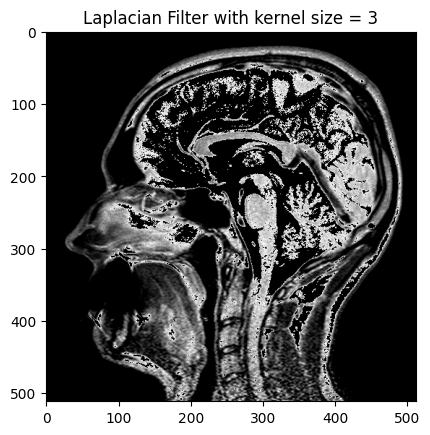

In [167]:
Filtered_image = Dlaplacian_filter(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dlaplacian_filter(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dlaplacian_filter(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply High Pass Filter

MSE: 51.08287811279297
SSIM: 0.5319979612675869
PSNR: 10.63420282094791 dB


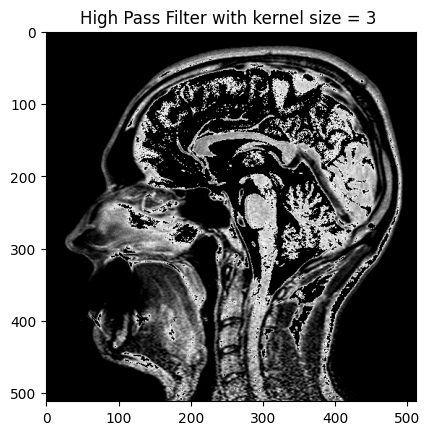

In [170]:
Filtered_image = Dhighpass_filter(Noisy_image, 3)

plt.imshow(Filtered_image)
plt.title('High Pass Filter with kernel size = 3 ')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dhighpass_filter(Noisy_image, 5)

plt.imshow(Filtered_image)
plt.title('High Pass Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dhighpass_filter(Noisy_image, 7)

plt.imshow(Filtered_image)
plt.title('High Pass Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Sobel Filter

MSE: 51.105045318603516
SSIM: 0.4595760346993941
PSNR: 10.545469706958245 dB


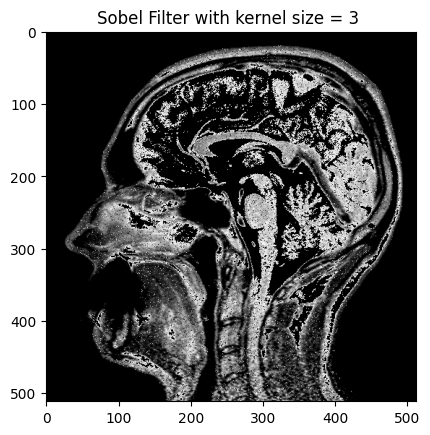

In [173]:
Filtered_image = Dsobel_filter(Noisy_image)

plt.imshow(Filtered_image)
plt.title('Sobel Filter with kernel size = 3 ')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Robert Filter

MSE: 51.05637741088867
SSIM: 0.46230831738610506
PSNR: 10.618908469964747 dB


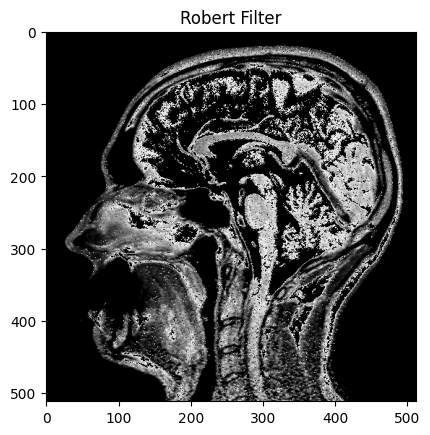

In [174]:
Filtered_image = Drobert_filter(Noisy_image)
plt.imshow(Filtered_image)
plt.title('Robert Filter')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Unsharp Masking Filter

MSE: 51.08287811279297
SSIM: 0.5319979612675869
PSNR: 10.63420282094791 dB


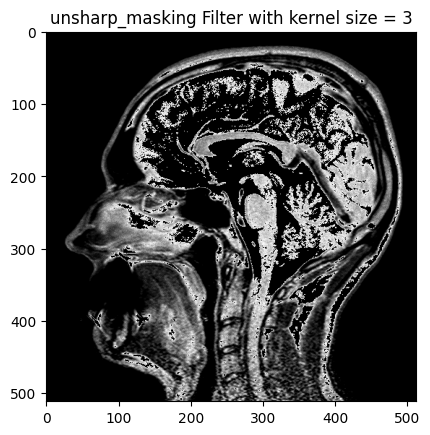

In [175]:
Filtered_image = Dunsharp_masking(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('unsharp_masking Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dunsharp_masking(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('unsharp_masking Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dunsharp_masking(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('unsharp_masking Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply High Boost Filter

MSE: 51.08287811279297
SSIM: 0.5319979612675869
PSNR: 10.63420282094791 dB


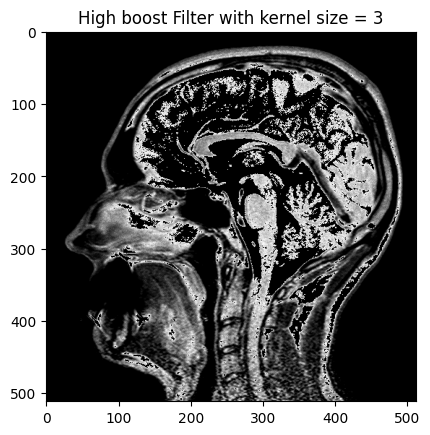

In [178]:
Filtered_image = Dhigh_boost(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dhigh_boost(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dhigh_boost(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Sharpening Filter

#### As it can be seen in the images below, Laplacian filters amplify noise more than other filters. It has highest MSE and lowest PSNR and SSIM.

## Apply Laplacian Filter

MSE: 55.885005950927734
SSIM: 0.37856976822322846
PSNR: 11.814395172979353 dB


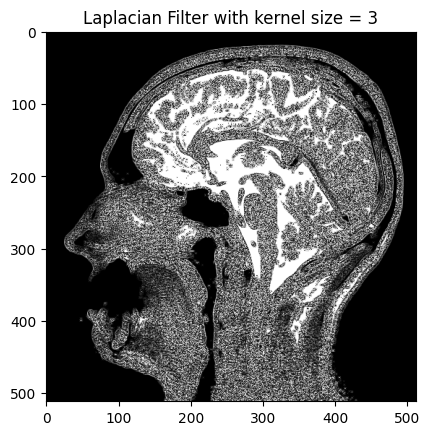

In [181]:
Filtered_image = laplacian_filter(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = laplacian_filter(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = laplacian_filter(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Sobel Filter

MSE: 65.29707717895508
SSIM: 0.3599574188610754
PSNR: 10.10902194488529 dB


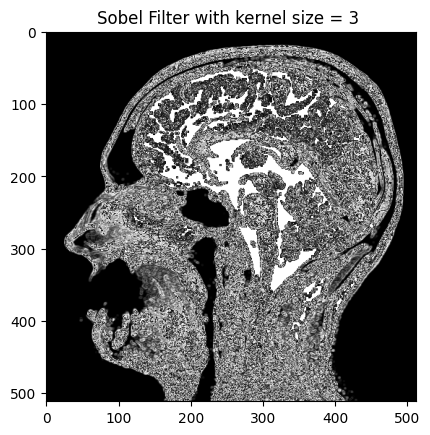

In [184]:
Filtered_image = sobel_filter(Noisy_image)

plt.imshow(Filtered_image)
plt.title('Sobel Filter with kernel size = 3 ')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Robert Filter

MSE: 61.895816802978516
SSIM: 0.7268083311538371
PSNR: 12.613755731305716 dB


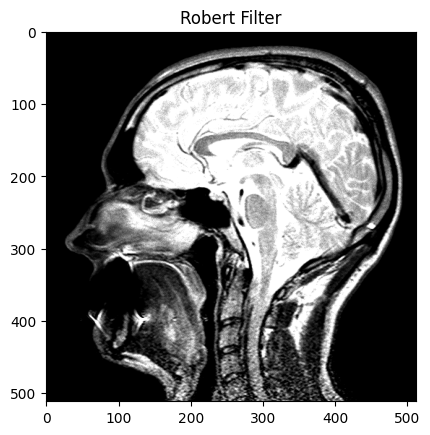

In [185]:
Filtered_image = robert_filter(Noisy_image)
plt.imshow(Filtered_image)
plt.title('Robert Filter')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Unsharp Masking Filter

MSE: 55.92021560668945
SSIM: 0.6639004076437963
PSNR: 12.399159113191597 dB


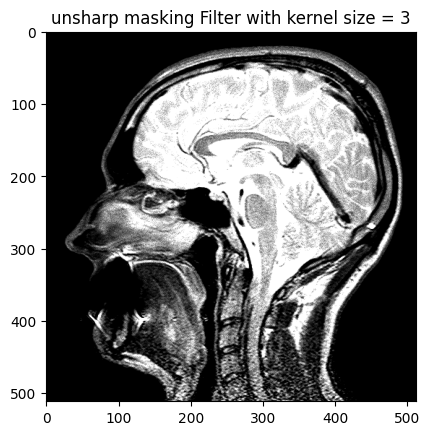

In [186]:
Filtered_image = unsharp_masking(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('unsharp masking Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = unsharp_masking(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('unsharp masking Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = unsharp_masking(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('unsharp masking Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply High Boost Filter

MSE: 54.17328643798828
SSIM: 0.6548157053417398
PSNR: 12.386381277924645 dB


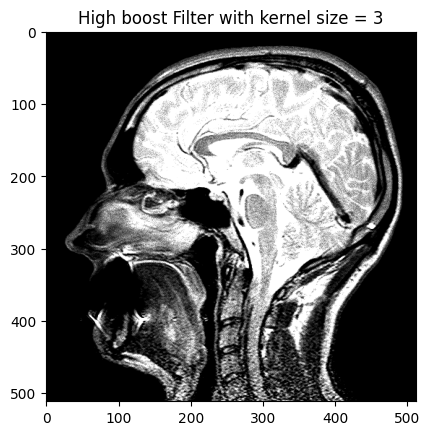

In [189]:
Filtered_image = high_boost(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = high_boost(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = high_boost(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Haar Wavelet Filter

MSE: 64.54092407226562
SSIM: 0.6937699102282248
PSNR: 12.703196004180175 dB


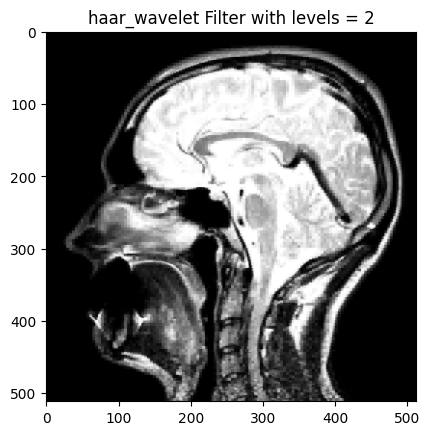

In [192]:
Filtered_image = haar_wavelet(Noisy_image,2 , 60)
plt.imshow(Filtered_image)
plt.title('haar_wavelet Filter with levels = 2')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = coiflet_wavelet(Noisy_image,3 , 60)
plt.imshow(Filtered_image)
plt.title('coiflet_wavelet Filter with levels = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = haar_wavelet(Noisy_image,4 , 60)
plt.imshow(Filtered_image)
plt.title('haar_wavelet Filter with levels = 4')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Coiflet Wavelet Filter

MSE: 64.4271125793457
SSIM: 0.7210020148230858
PSNR: 12.745475724437627 dB


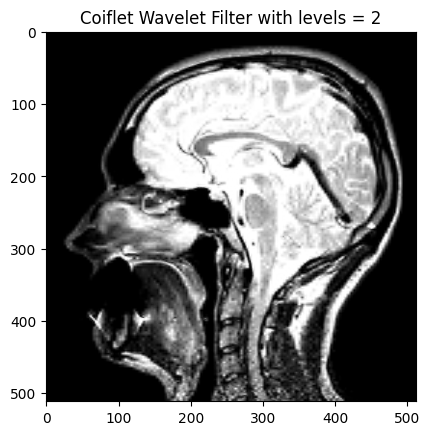

In [195]:
Filtered_image = coiflet_wavelet(Noisy_image, 2, 60)
plt.imshow(Filtered_image)
plt.title('Coiflet Wavelet Filter with levels = 2')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = coiflet_wavelet(Noisy_image, 3, 60)
plt.imshow(Filtered_image)
plt.title('Coiflet Wavelet Filter with levels = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = coiflet_wavelet(Noisy_image, 4, 60)
plt.imshow(Filtered_image)
plt.title('Coiflet Wavelet Filter with levels = 4')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Daubechies Wavelet Filter

In [ ]:
Filtered_image = daubechies_wavelet(Noisy_image, 2, 60)
plt.imshow(Filtered_image)
plt.title('Daubechies Wavelet Filter with levels = 2')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

MSE: 66.69181060791016
SSIM: 0.6582181393349305
PSNR: 12.78308549209167 dB


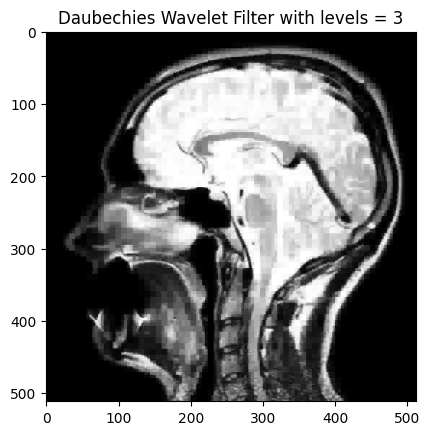

In [199]:
Filtered_image = daubechies_wavelet(Noisy_image, 3, 60)
plt.imshow(Filtered_image)
plt.title('Daubechies Wavelet Filter with levels = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = daubechies_wavelet(Noisy_image, 4, 60)
plt.imshow(Filtered_image)
plt.title('Daubechies Wavelet Filter with levels = 4')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Symlets Wavelet Filter

MSE: 64.6402702331543
SSIM: 0.7185745039898607
PSNR: 12.742010869526812 dB


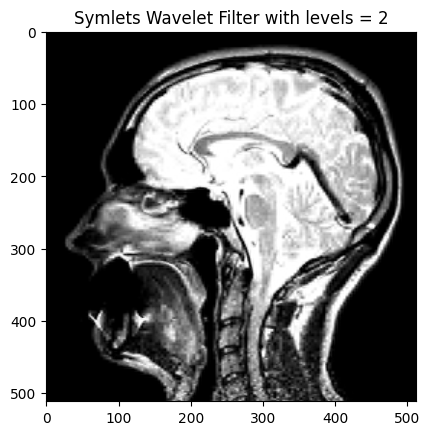

In [201]:
Filtered_image = symlets_wavelet(Noisy_image, 2, 60)
plt.imshow(Filtered_image)
plt.title('Symlets Wavelet Filter with levels = 2')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = symlets_wavelet(Noisy_image, 3, 60)
plt.imshow(Filtered_image)
plt.title('Symlets Wavelet Filter with levels = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = symlets_wavelet(Noisy_image, 4, 60)
plt.imshow(Filtered_image)
plt.title('Symlets Wavelet Filter with levels = 4')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Shearlet Filter

MSE: 0.0542
SSIM: 0.7091
PSNR: 12.66 dB


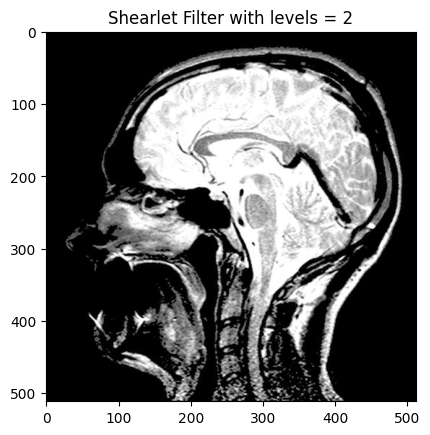

In [204]:
Filtered_image = cv2.imread('denoisedPoisson2.jpg', cv2.IMREAD_GRAYSCALE)
plt.imshow(Filtered_image)
plt.title('Shearlet Filter with levels = 2')
MSE = 0.0542
SSIM = 0.7091
PSNR = 12.66

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = cv2.imread('denoisedPoisson3.jpg', cv2.IMREAD_GRAYSCALE)
plt.imshow(Filtered_image)
plt.title('Shearlet Filter with levels = 3')
MSE = 0.0542
SSIM = 0.7091
PSNR = 12.66

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = cv2.imread('denoisedspeckle4.jpg', cv2.IMREAD_GRAYSCALE)
plt.imshow(Filtered_image)
plt.title('Shearlet Filter with levels = 4')
MSE = 0.0011
SSIM = 0.8579
PSNR = 29.43

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [207]:
def statistic_poisson(dataSet_type, images_count):
    avg_filter_ssim = []
    avg_filter_psnr = []

    images_count += 1
    
    for filter in range(13):
            if filter == 0:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = poisson_noise(image, 0.5) 
                    Filtered_image = median_filter(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
                
            
            elif filter == 1:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = poisson_noise(image, 0.5) 
                    Filtered_image = average_filter(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
                
            
            elif filter == 2:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = poisson_noise(image, 0.5) 
                    sigma_r = 70
                    sigma_s = 80
                    Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 3:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = poisson_noise(image, 0.5) 
                    Filtered_image = Dlaplacian_filter(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 4:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = poisson_noise(image, 0.5) 
                    Filtered_image = Dhighpass_filter(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 5:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = poisson_noise(image, 0.5) 
                    Filtered_image = Dsobel_filter(Noisy_image)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            elif filter == 6:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = poisson_noise(image, 0.5) 
                    Filtered_image = Drobert_filter(Noisy_image)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    

            elif filter == 7:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = poisson_noise(image, 0.5) 
                    Filtered_image = Dunsharp_masking(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
           
            elif filter == 8:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = poisson_noise(image, 0.5) 
                    Filtered_image = Dhigh_boost(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 9:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    if image.shape[0] != image.shape[1]:
                        image = add_padding(image, max(image.shape[0], image.shape[1]))
                    Noisy_image = poisson_noise(image, 0.5) 
                    Filtered_image = haar_wavelet(Noisy_image, 3, 60)
                    if image.shape[0] != Filtered_image.shape[0]:
                        image = add_padding(image, max(image.shape[0], Filtered_image.shape[0]))
                        Filtered_image = add_padding(Filtered_image, max(image.shape[0], Filtered_image.shape[0]))
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            elif filter == 10:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    if image.shape[0] != image.shape[1]:
                        image = add_padding(image, max(image.shape[0], image.shape[1]))
                    Noisy_image = poisson_noise(image, 0.5) 
                    Filtered_image = coiflet_wavelet(Noisy_image, 3, 60)
                    if image.shape[0] != Filtered_image.shape[0]:
                        image = add_padding(image, max(image.shape[0], Filtered_image.shape[0]))
                        Filtered_image = add_padding(Filtered_image, max(image.shape[0], Filtered_image.shape[0]))
                    
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
           
            elif filter == 11:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    if image.shape[0] != image.shape[1]:
                        image = add_padding(image, max(image.shape[0], image.shape[1]))
                    Noisy_image = poisson_noise(image, 0.5) 
                    Filtered_image = daubechies_wavelet(Noisy_image, 3, 60)
                    if image.shape[0] != Filtered_image.shape[0]:
                        image = add_padding(image, max(image.shape[0], Filtered_image.shape[0]))
                        Filtered_image = add_padding(Filtered_image, max(image.shape[0], Filtered_image.shape[0]))
                    
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 12:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    if image.shape[0] != image.shape[1]:
                        image = add_padding(image, max(image.shape[0], image.shape[1]))
                    Noisy_image = poisson_noise(image, 0.5) 
                    Filtered_image = symlets_wavelet(Noisy_image, 3, 60)
                    if image.shape[0] != Filtered_image.shape[0]:
                        image = add_padding(image, max(image.shape[0], Filtered_image.shape[0]))
                        Filtered_image = add_padding(Filtered_image, max(image.shape[0], Filtered_image.shape[0]))
                    
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
    filters = ['Median', 'Average', 'Bilateral', 'Laplacian', 'High Pass', 'Sobel', 'Robert', 'Unsharp masking', 
           'High Boost', 'Haar Wavelet', 'Coifler Wavelet', 'Daubechies Wavelet', 'Symlets Wavelet']
    print(dataSet_type + ' Images')
    # Plotting SSIM scores
    plt.figure(figsize=(20, 5))
    plt.bar(filters, avg_filter_ssim, color='skyblue')
    max_ssim = max(avg_filter_ssim)
    for i, value in enumerate(avg_filter_ssim):
        if value == max_ssim:
            plt.bar(i, value, color='blue')
    plt.xlabel('Filters')
    plt.ylabel('Average SSIM Score')
    plt.title('Average SSIM Scores for Different Filters')
    plt.tight_layout() 
    plt.show()

    # Plotting PSNR scores
    plt.figure(figsize=(20, 5))
    plt.bar(filters, avg_filter_psnr, color='salmon')
    max_psnr = max(avg_filter_psnr)
    for i, value in enumerate(avg_filter_psnr):
        if value == max_psnr:
            plt.bar(i, value, color='red')
    plt.xlabel('Filters')
    plt.ylabel('Average PSNR Score')
    plt.title('Average PSNR Scores for Different Filters')
    plt.tight_layout() 
    plt.show()


Med Images


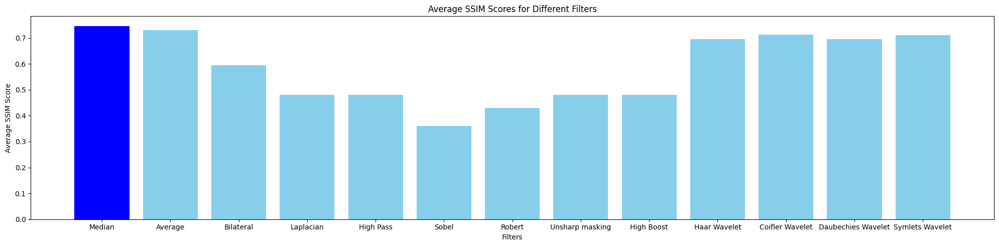

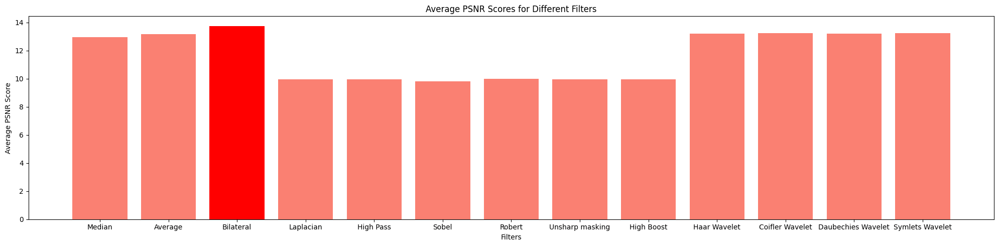

In [208]:
statistic_poisson('Med', 24)

Normal Images


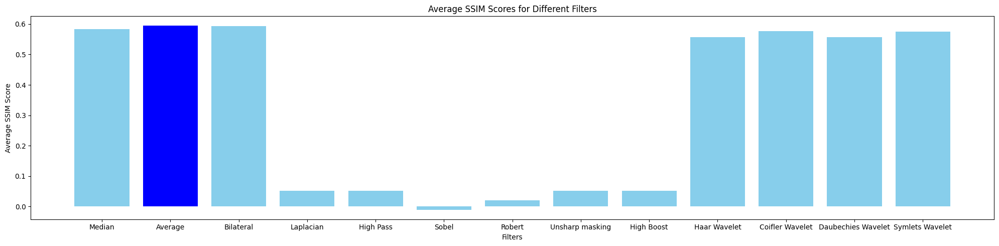

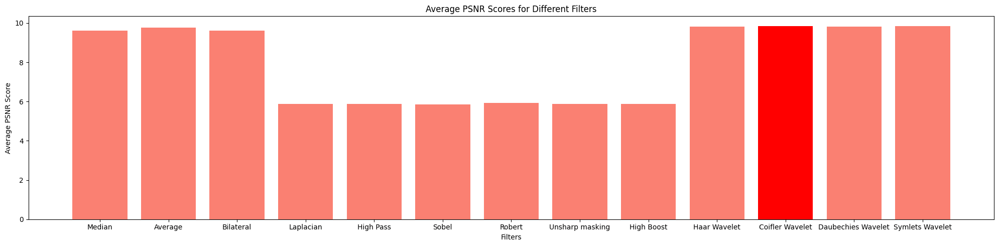

In [209]:
statistic_poisson('Normal', 15)

RS Images


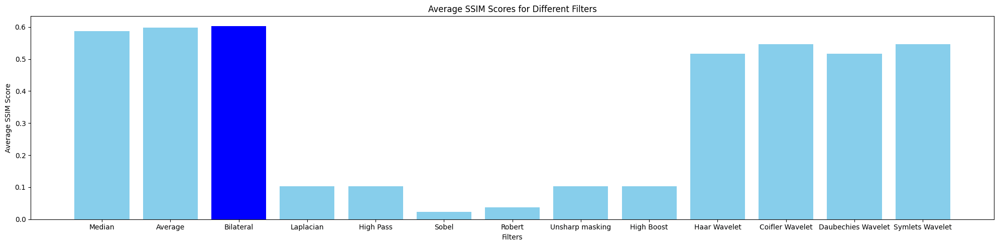

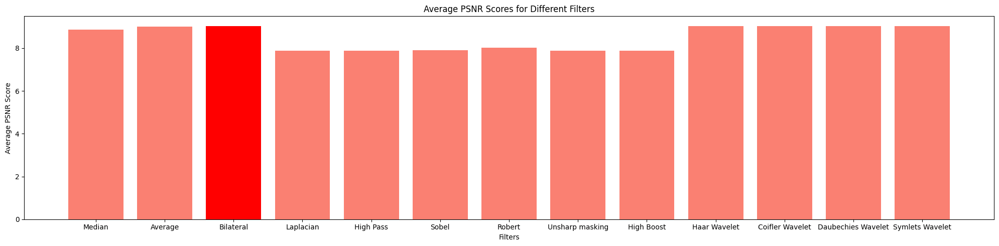

In [210]:
statistic_poisson('RS', 15)

# Applying Gaussian Noise

#### Gaussian noise with different means and standard deviations are applied. As it can be seen,increasing the mean of the Gaussian noise shifts the noise distribution toward higher intensity values and in these cases made the images brighter while Increasing the standard deviation results in more intense and widespread noise, causing more variation in pixel intensities across the image so that this factor can significantly effect on image structure (SSIM) as it can be seen by increasing standard deviation, SSIM decreased. MSE measure difference between pixels so both factors mean and standard deviation are effective and by increasing these factors, MSE also increase. PSNR measures the ratio between the maximum possible power of a signal and the power of corrupting noise so by increasing mean or standard deviation PSNR decrease.

MSE: 78.92813110351562
SSIM: 0.20947001857934577
PSNR: 17.695548361820805 dB


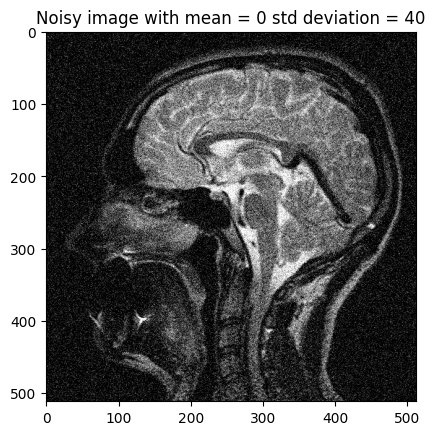

In [211]:
Noisy_image = gaussian_noise(med_img, 0, 40) 
plt.imshow(Noisy_image)
plt.title('Noisy image with mean = 0 std deviation = 40')

MSE = np.mean((med_img - Noisy_image) ** 2)
SSIM = ssim(med_img, Noisy_image, multichannel=True)
PSNR = psnr(med_img, Noisy_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Noisy_image = gaussian_noise(med_img, 4, 30) 
plt.imshow(Noisy_image)
plt.title('Noisy image with mean = 4 std deviation = 30')

MSE = np.mean((med_img - Noisy_image) ** 2)
SSIM = ssim(med_img, Noisy_image, multichannel=True)
PSNR = psnr(med_img, Noisy_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Noisy_image = gaussian_noise(med_img, 10, 0) 
plt.imshow(Noisy_image)
plt.title('Noisy image with mean = 10 std deviation = 0')

MSE = np.mean((med_img - Noisy_image) ** 2)
SSIM = ssim(med_img, Noisy_image, multichannel=True)
PSNR = psnr(med_img, Noisy_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Noisy_image = gaussian_noise(med_img, 10, 25) 
plt.imshow(Noisy_image)
plt.title('Noisy image with mean = 10 std deviation = 25')

MSE = np.mean((med_img - Noisy_image) ** 2)
SSIM = ssim(med_img, Noisy_image, multichannel=True)
PSNR = psnr(med_img, Noisy_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

# Applying Filters for Gaussian Noisy images

#### we choose image with mean = 4 and standard deviation = 30 and apply filters to compare them

In [215]:
Noisy_image = gaussian_noise(med_img, 4, 30)
cv2.imwrite('gaussian_noise.png', Noisy_image)

True

## Apply Median Filter

In [ ]:
Filtered_image = median_filter(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('Median Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

MSE: 58.53961944580078
SSIM: 0.5573180442832607
PSNR: 27.116858408993313 dB


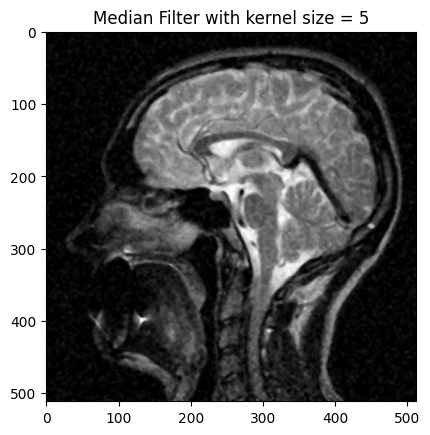

In [217]:
Filtered_image = median_filter(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('Median Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = median_filter(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('Median Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

#### As it can be seen in the images above, by increasing the kenrel size, noise reduce and images blur more and more while the smaller kernel sizes preserved finer details. kernel size 3x3 removed some amount of noise, but it preserved fine details. A 5x5 kernel size had a stronger denoising effect compared to the 3x3 kernel.It removed more noise, but it blur the image more compare to the smaller kernel. This kernel size is the best among these three kernels and balances blurring and noise reduction so that its SSIM and PSNR are the highest and its MSE is the least. A 7x7 kernel size had more pronounced smoothing effect.It removed more noise ,but it also blurs the image more noticeably compared to smaller kernel sizes.

## Apply Average Filter

MSE: 84.68047714233398
SSIM: 0.49215002100191335
PSNR: 25.47341964740514 dB


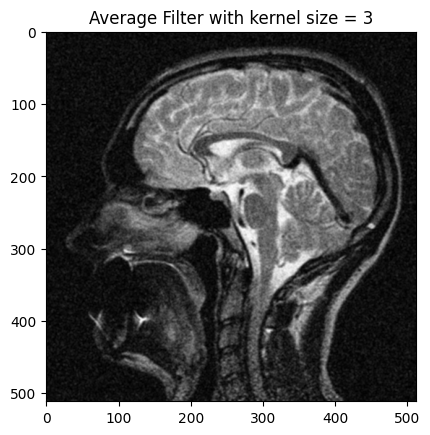

In [219]:
Filtered_image = average_filter(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('Average Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = average_filter(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('Average Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = average_filter(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('Average Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

#### As it can be seen in the images above, by increasing the kernel size, images become blur more and more and more details and edges of image are loosing at each step so that SSIM and MSE which show structure and pixel differences with original image are also decreasing. noise is also reducing. The effect of loosing edges and details is more than denoising so that PPSNR is decreasing slightly.   

## Apply Bilateral Filter

MSE: 108.99267196655273
SSIM: 0.3038566033660873
PSNR: 20.2232974661429 dB


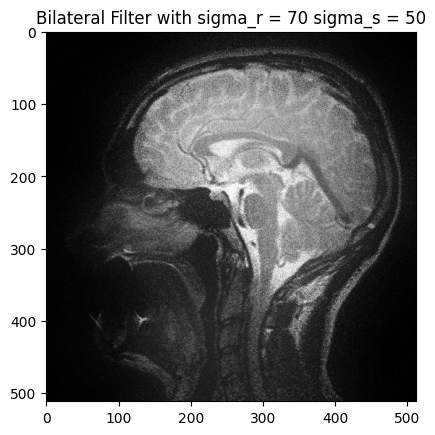

In [222]:
sigma_r = 70
sigma_s = 50
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 70 sigma_s = 50')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
sigma_r = 90
sigma_s = 50
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 90 sigma_s = 50')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
sigma_r = 110
sigma_s = 50
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 110 sigma_s = 50')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
sigma_r = 70
sigma_s = 60
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 70 sigma_s = 60')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
sigma_r = 70
sigma_s = 80
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 70 sigma_s = 80')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
sigma_r = 70
sigma_s = 100
Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
plt.imshow(Filtered_image)
plt.title('Bilateral Filter with sigma_r = 70 sigma_s = 100')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

#### As it can be seen in the first 3 images above, sigma_s = 50 and sigma_r differs from 70 to 110. sigma_r controls the bandwidth of the instensity gaussian and A larger sigma_r means more neighboring pixels with differing intensities are included in the filtering process so by increasing this factor, image become smoother and loose some details while reduce more noise. because of loosing details and edges MSE is increasing and SSIM is dcreasing.The effect of denoising is less than smoothing so PSNR is also decreasing. As it can be seen in the second 3 images above, sigma_r = 70 and sigma_s differs from 60 to 100. sigma_s controls the spatial bandwidth so by increasing the amount of sigma_s, encompass a wider spatial area and it cause to blur more and loss details. because of loosing details and edges MSE is increasing and SSIM is dcreasing.The effect of denoising is less than smoothing so PSNR is also decreasing.

## Apply Denosing Sharpening Filters

## Apply Laplacian Filter

MSE: 77.91290664672852
SSIM: 0.24341640044981014
PSNR: 17.491668179683725 dB


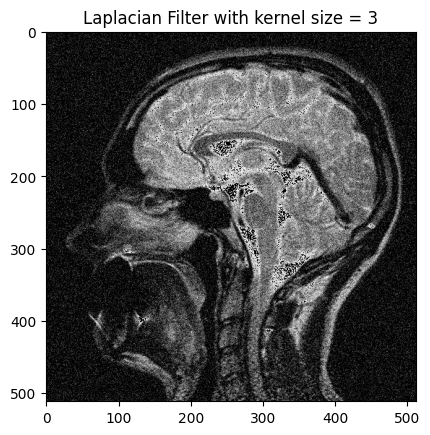

In [228]:
Filtered_image = Dlaplacian_filter(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dlaplacian_filter(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dlaplacian_filter(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply High Pass Filter

In [ ]:
Filtered_image = Dhighpass_filter(Noisy_image, 3)

plt.imshow(Filtered_image)
plt.title('High Pass Filter with kernel size = 3 ')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

MSE: 77.91264724731445
SSIM: 0.24341611178484793
PSNR: 17.491672812830814 dB


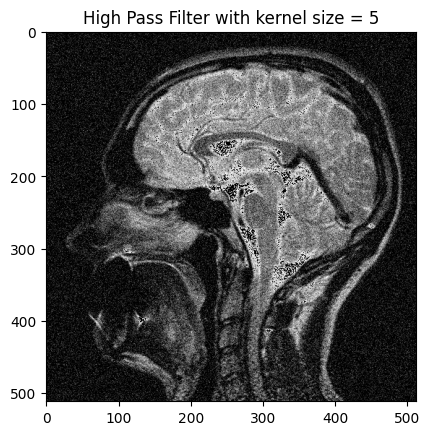

In [232]:
Filtered_image = Dhighpass_filter(Noisy_image, 5)

plt.imshow(Filtered_image)
plt.title('High Pass Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dhighpass_filter(Noisy_image, 7)

plt.imshow(Filtered_image)
plt.title('High Pass Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Sobel Filter

MSE: 78.49465942382812
SSIM: 0.17755479281945907
PSNR: 15.557753251148167 dB


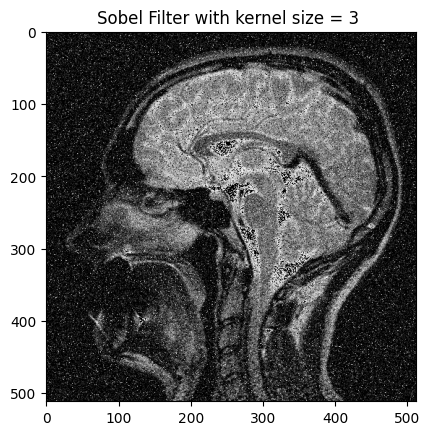

In [234]:
Filtered_image = Dsobel_filter(Noisy_image)

plt.imshow(Filtered_image)
plt.title('Sobel Filter with kernel size = 3 ')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Robert Filter

MSE: 78.14999389648438
SSIM: 0.17268329492177864
PSNR: 15.538135349102804 dB


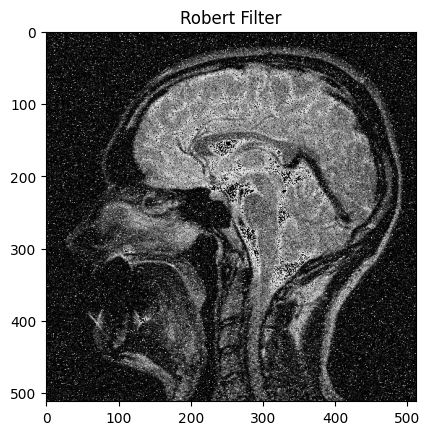

In [235]:
Filtered_image = Drobert_filter(Noisy_image)
plt.imshow(Filtered_image)
plt.title('Robert Filter')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Unsharp Masking Filter

In [ ]:
Filtered_image = Dunsharp_masking(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('unsharp_masking Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")## Apply Unsharp Masking Filter

MSE: 77.91263961791992
SSIM: 0.2434314610278272
PSNR: 17.491991339244088 dB


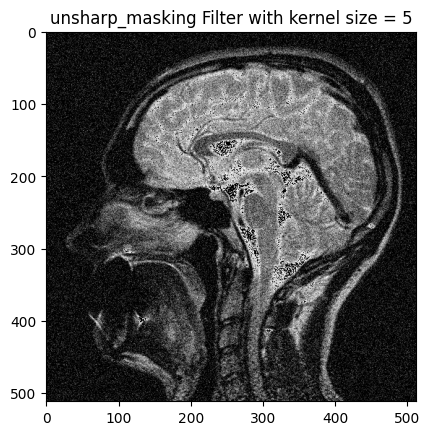

In [237]:
Filtered_image = Dunsharp_masking(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('unsharp_masking Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dunsharp_masking(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('unsharp_masking Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply High Boost Filter

MSE: 77.91263961791992
SSIM: 0.2434314610278272
PSNR: 17.491991339244088 dB


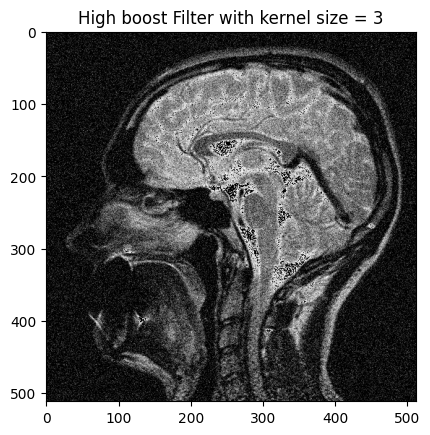

In [239]:
Filtered_image = Dhigh_boost(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dhigh_boost(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = Dhigh_boost(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Sharpening Filter

#### As it can be seen in the images below, Laplacian filters amplify noise more than other filters. It has highest MSE and lowest PSNR and SSIM.

## Apply Laplacian Filter

MSE: 100.51372146606445
SSIM: 0.004973676384454824
PSNR: 7.788006159798994 dB


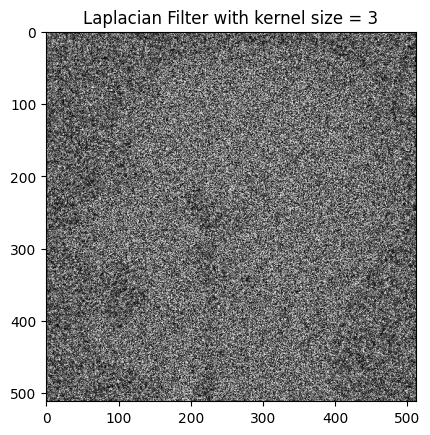

In [242]:
Filtered_image = laplacian_filter(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = laplacian_filter(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = laplacian_filter(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('Laplacian Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Sobel Filter

MSE: 107.08308029174805
SSIM: 0.005481307311886612
PSNR: 7.805814518929005 dB


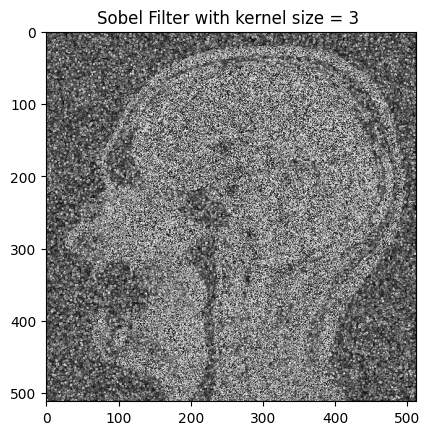

In [245]:
Filtered_image = sobel_filter(Noisy_image)

plt.imshow(Filtered_image)
plt.title('Sobel Filter with kernel size = 3 ')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Robert Filter

MSE: 76.6207275390625
SSIM: 0.2766631462257421
PSNR: 19.775869550551757 dB


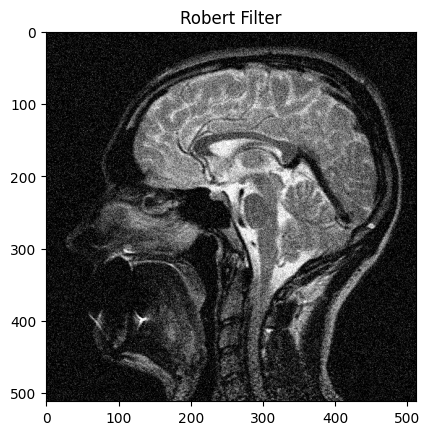

In [246]:
Filtered_image = robert_filter(Noisy_image)
plt.imshow(Filtered_image)
plt.title('Robert Filter')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Unsharp Masking Filter

MSE: 79.40520858764648
SSIM: 0.16162338291595305
PSNR: 15.36536673372954 dB


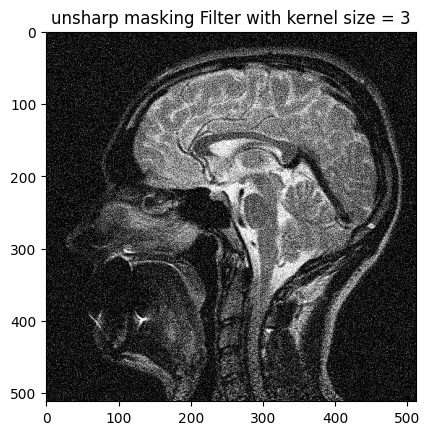

In [247]:
Filtered_image = unsharp_masking(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('unsharp masking Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = unsharp_masking(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('unsharp masking Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = unsharp_masking(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('unsharp masking Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply High Boost Filter

MSE: 79.29941177368164
SSIM: 0.14847158701273022
PSNR: 14.77055201856949 dB


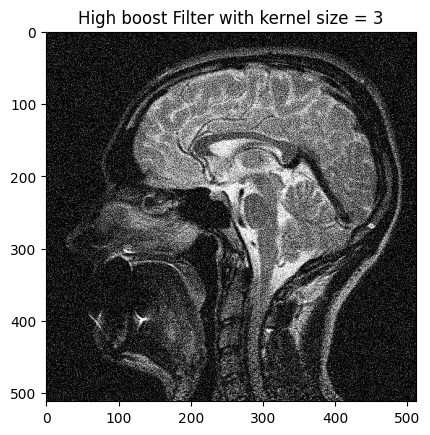

In [250]:
Filtered_image = high_boost(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = high_boost(Noisy_image,5)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 5')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = high_boost(Noisy_image,7)
plt.imshow(Filtered_image)
plt.title('High boost Filter with kernel size = 7')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Haar Wavelet Filter

MSE: 89.93876266479492
SSIM: 0.36973627874045395
PSNR: 23.003062362363526 dB


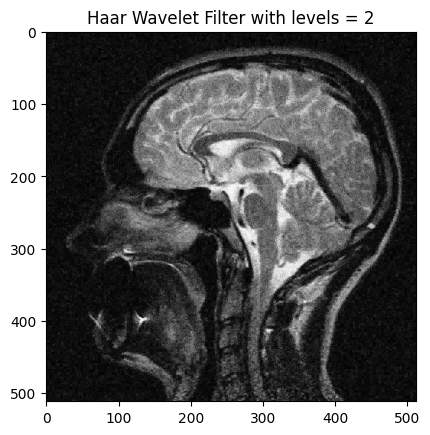

In [253]:
Filtered_image = haar_wavelet(Noisy_image,2)
plt.imshow(Filtered_image)
plt.title('Haar Wavelet Filter with levels = 2')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = haar_wavelet(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('Haar Wavelet Filter with levels = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = haar_wavelet(Noisy_image,4)
plt.imshow(Filtered_image)
plt.title('Haar Wavelet Filter with levels = 4')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Coiflet Wavelet Filter

MSE: 88.28525161743164
SSIM: 0.3811697237376745
PSNR: 23.197774187007273 dB


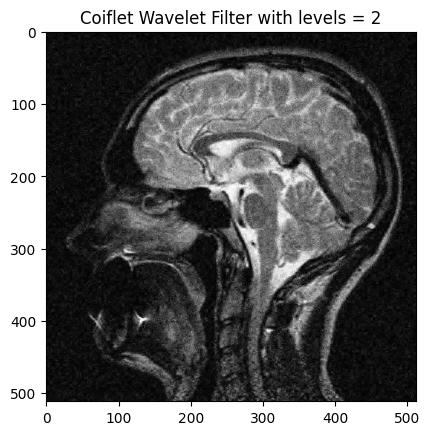

In [256]:
Filtered_image = coiflet_wavelet(Noisy_image,2)
plt.imshow(Filtered_image)
plt.title('Coiflet Wavelet Filter with levels = 2')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = coiflet_wavelet(Noisy_image,3)
plt.imshow(Filtered_image)
plt.title('Coiflet Wavelet Filter with levels = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = coiflet_wavelet(Noisy_image,4)
plt.imshow(Filtered_image)
plt.title('Coiflet Wavelet Filter with levels = 4')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Daubechies Wavelet Filter

In [ ]:
Filtered_image = daubechies_wavelet(Noisy_image, 2, 60)
plt.imshow(Filtered_image)
plt.title('Daubechies Wavelet Filter with levels = 2')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

MSE: 103.2003402709961
SSIM: 0.36536295176995826
PSNR: 23.565969726333233 dB


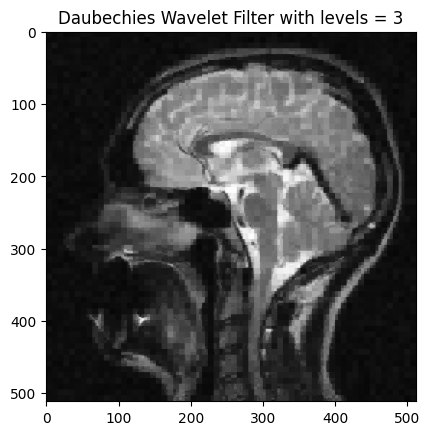

In [261]:
Filtered_image = daubechies_wavelet(Noisy_image, 3, 60)
plt.imshow(Filtered_image)
plt.title('Daubechies Wavelet Filter with levels = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = daubechies_wavelet(Noisy_image, 4, 60)
plt.imshow(Filtered_image)
plt.title('Daubechies Wavelet Filter with levels = 4')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Symlets Wavelet Filter

MSE: 90.15478897094727
SSIM: 0.4572563563903776
PSNR: 24.989013340792702 dB


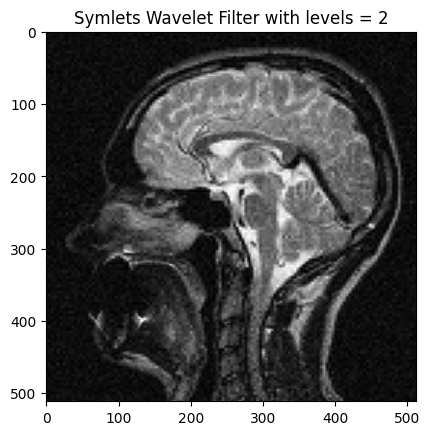

In [263]:
Filtered_image = symlets_wavelet(Noisy_image, 2, 60)
plt.imshow(Filtered_image)
plt.title('Symlets Wavelet Filter with levels = 2')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = symlets_wavelet(Noisy_image, 3, 60)
plt.imshow(Filtered_image)
plt.title('Symlets Wavelet Filter with levels = 3')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = symlets_wavelet(Noisy_image, 4, 60)
plt.imshow(Filtered_image)
plt.title('Symlets Wavelet Filter with levels = 4')

MSE = np.mean((med_img - Filtered_image) ** 2)
SSIM = ssim(med_img, Filtered_image, multichannel=True)
PSNR = psnr(med_img, Filtered_image)

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

## Apply Shearlet Filter

MSE: 0.0031
SSIM: 0.7116
PSNR: 25.03 dB


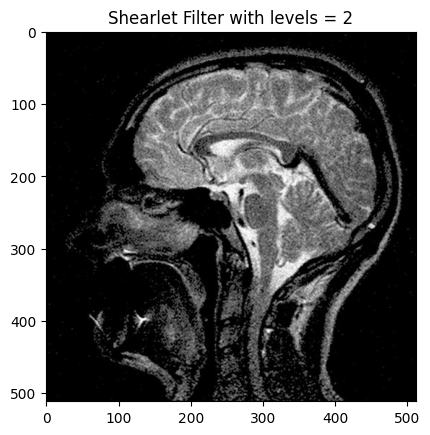

In [266]:
Filtered_image = cv2.imread('denoisedGaussian2.jpg', cv2.IMREAD_GRAYSCALE)
plt.imshow(Filtered_image)
plt.title('Shearlet Filter with levels = 2')
MSE = 0.0031
SSIM = 0.7116
PSNR = 25.03

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = cv2.imread('denoisedGaussian3.jpg', cv2.IMREAD_GRAYSCALE)
plt.imshow(Filtered_image)
plt.title('Shearlet Filter with levels = 3')
MSE = 0.0031
SSIM = 0.7116
PSNR = 25.03

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [ ]:
Filtered_image = cv2.imread('denoisedGaussian4.jpg', cv2.IMREAD_GRAYSCALE)
plt.imshow(Filtered_image)
plt.title('Shearlet Filter with levels = 4')
MSE = 0.0031
SSIM = 0.7116
PSNR = 25.03

print(f"MSE: {MSE}")
print(f"SSIM: {SSIM}")
print(f"PSNR: {PSNR} dB")

In [269]:
def statistic_gaussian(dataSet_type, images_count):
    avg_filter_ssim = []
    avg_filter_psnr = []

    images_count += 1
    
    for filter in range(13):
            if filter == 0:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = gaussian_noise(image, 4, 30)
                    Filtered_image = median_filter(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
                
            
            elif filter == 1:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = gaussian_noise(image, 4, 30)
                    Filtered_image = average_filter(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
                
            
            elif filter == 2:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = gaussian_noise(image, 4, 30)
                    sigma_r = 70
                    sigma_s = 80
                    Filtered_image = bilateral_filter(Noisy_image, sigma_r, sigma_s)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 3:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = gaussian_noise(image, 4, 30)
                    Filtered_image = Dlaplacian_filter(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 4:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = gaussian_noise(image, 4, 30)
                    Filtered_image = Dhighpass_filter(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 5:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = gaussian_noise(image, 4, 30)
                    Filtered_image = Dsobel_filter(Noisy_image)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            elif filter == 6:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = gaussian_noise(image, 4, 30)
                    Filtered_image = Drobert_filter(Noisy_image)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    

            elif filter == 7:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = gaussian_noise(image, 4, 30)
                    Filtered_image = Dunsharp_masking(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
           
            elif filter == 8:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    Noisy_image = gaussian_noise(image, 4, 30)
                    Filtered_image = Dhigh_boost(Noisy_image,5)
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 9:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    if image.shape[0] != image.shape[1]:
                        image = add_padding(image, max(image.shape[0], image.shape[1]))
                    Noisy_image = gaussian_noise(image, 4, 30)
                    Filtered_image = haar_wavelet(Noisy_image, 3, 60)
                    if image.shape[0] != Filtered_image.shape[0]:
                        image = add_padding(image, max(image.shape[0], Filtered_image.shape[0]))
                        Filtered_image = add_padding(Filtered_image, max(image.shape[0], Filtered_image.shape[0]))  
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            elif filter == 10:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    if image.shape[0] != image.shape[1]:
                        image = add_padding(image, max(image.shape[0], image.shape[1]))
                    Noisy_image = gaussian_noise(image, 4, 30)
                    Filtered_image = coiflet_wavelet(Noisy_image, 3, 60)
                    if image.shape[0] != Filtered_image.shape[0]:
                        image = add_padding(image, max(image.shape[0], Filtered_image.shape[0]))
                        Filtered_image = add_padding(Filtered_image, max(image.shape[0], Filtered_image.shape[0])) 
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
           
            elif filter == 11:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    if image.shape[0] != image.shape[1]:
                        image = add_padding(image, max(image.shape[0], image.shape[1]))
                    Noisy_image = gaussian_noise(image, 4, 30)
                    Filtered_image = daubechies_wavelet(Noisy_image, 3, 60)
                    if image.shape[0] != Filtered_image.shape[0]:
                        image = add_padding(image, max(image.shape[0], Filtered_image.shape[0]))
                        Filtered_image = add_padding(Filtered_image, max(image.shape[0], Filtered_image.shape[0]))  
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
            elif filter == 12:
                _ssim = []
                _psnr = []
                for i in range(1, images_count):
                    image = cv2.imread('DS/' + dataSet_type + '/'+ str(i) +'.png', cv2.IMREAD_GRAYSCALE)
                    if image.shape[0] != image.shape[1]:
                        image = add_padding(image, max(image.shape[0], image.shape[1]))
                    Noisy_image = gaussian_noise(image, 4, 30)
                    Filtered_image = symlets_wavelet(Noisy_image, 3, 60)
                    if image.shape[0] != Filtered_image.shape[0]:
                        image = add_padding(image, max(image.shape[0], Filtered_image.shape[0]))
                        Filtered_image = add_padding(Filtered_image, max(image.shape[0], Filtered_image.shape[0]))
                    SSIM = ssim(image, Filtered_image, multichannel=True)
                    PSNR = psnr(image, Filtered_image)
                    _ssim.append(SSIM)
                    _psnr.append(PSNR)
    
                avg_filter_ssim.insert(filter, sum(_ssim) / len(_ssim))
                avg_filter_psnr.insert(filter, sum(_psnr) / len(_psnr))
    
            
    filters = ['Median', 'Average', 'Bilateral', 'Laplacian', 'High Pass', 'Sobel', 'Robert', 'Unsharp masking', 
           'High Boost', 'Haar Wavelet', 'Coifler Wavelet', 'Daubechies Wavelet', 'Symlets Wavelet']
    print(dataSet_type + ' Images')
    # Plotting SSIM scores
    plt.figure(figsize=(20, 5))
    plt.bar(filters, avg_filter_ssim, color='skyblue')
    max_ssim = max(avg_filter_ssim)
    for i, value in enumerate(avg_filter_ssim):
        if value == max_ssim:
            plt.bar(i, value, color='blue')
    plt.xlabel('Filters')
    plt.ylabel('Average SSIM Score')
    plt.title('Average SSIM Scores for Different Filters')
    plt.tight_layout() 
    plt.show()

    # Plotting PSNR scores
    plt.figure(figsize=(20, 5))
    plt.bar(filters, avg_filter_psnr, color='salmon')
    max_psnr = max(avg_filter_psnr)
    for i, value in enumerate(avg_filter_psnr):
        if value == max_psnr:
            plt.bar(i, value, color='red')
    plt.xlabel('Filters')
    plt.ylabel('Average PSNR Score')
    plt.title('Average PSNR Scores for Different Filters')
    plt.tight_layout() 
    plt.show()


Med Images


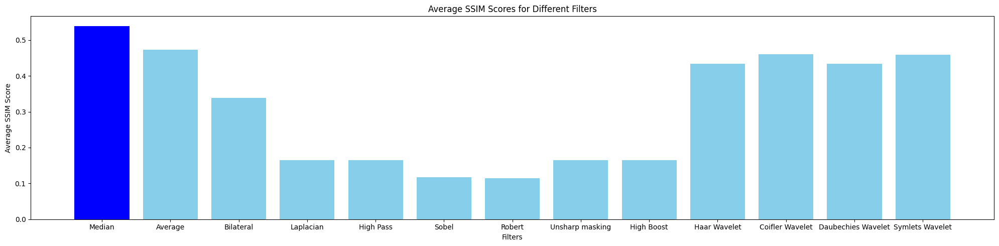

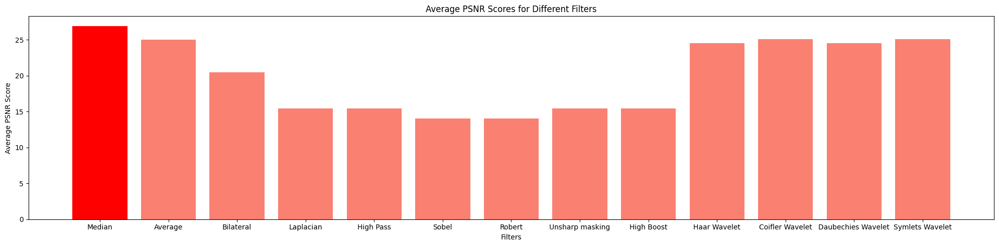

In [270]:
statistic_gaussian('Med', 24)

Normal Images


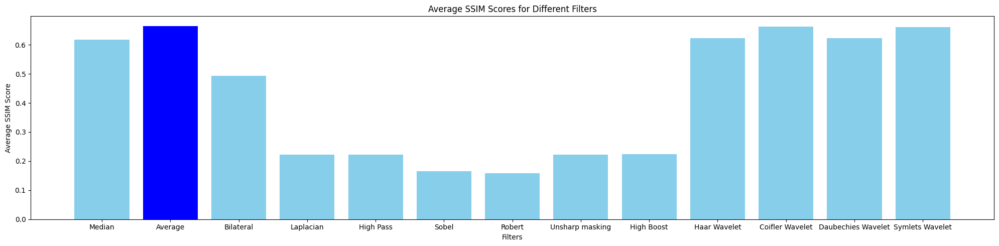

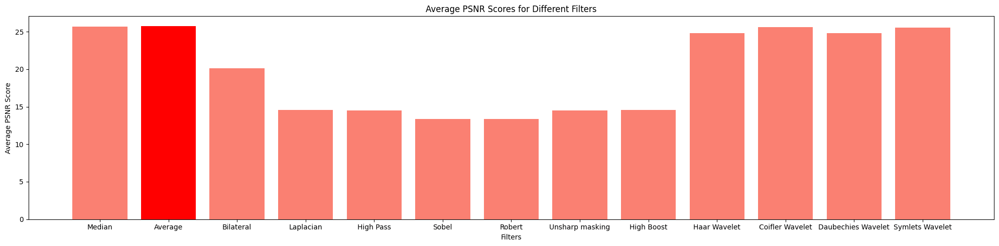

In [271]:
statistic_gaussian('Normal', 15)

RS Images


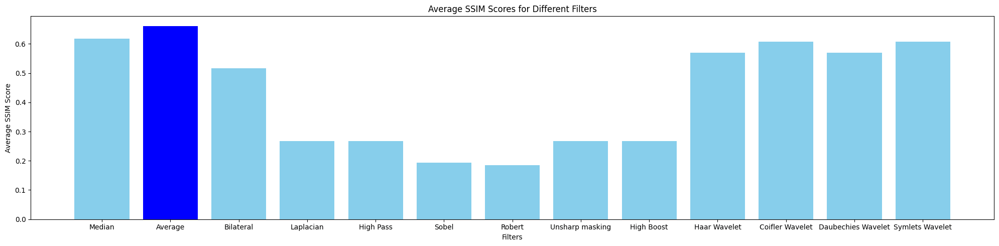

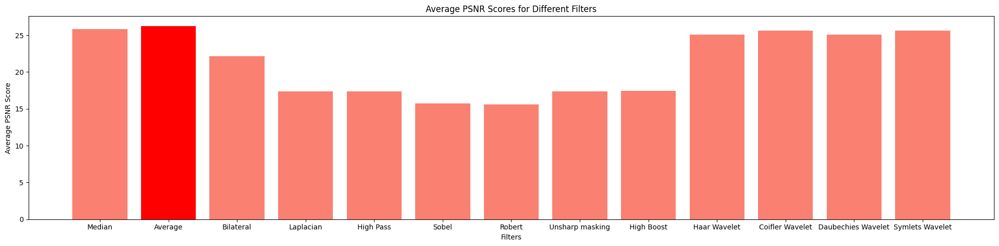

In [273]:
statistic_gaussian('RS', 15)